# Int

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm, SymLogNorm, TwoSlopeNorm
import matplotlib.colors as colors
import qcodes as qc
import qcodes.instrument_drivers.nplab_drivers as npd
from scipy.optimize import curve_fit
from scipy.interpolate import interp2d, interp1d
from os import path
import colorcet as cc   # install quickly with "conda install colorcet"
from scipy.interpolate import RectBivariateSpline
from matplotlib import ticker
from scipy.ndimage import gaussian_filter
import matplotlib as mpl
from lmfit import Model

In [3]:
import scipy.io

In [4]:
from matplotlib import cm

In [5]:
from scipy.signal import find_peaks

In [6]:
from mpl_toolkits.mplot3d import Axes3D

In [7]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams['figure.dpi'] = 300
%config InlineBackend.figure_format = 'svg'  # with this, we need to raster the pcolormesh images with rasterized=True
# and save with .svg in the filename. don't worry. The annoying white line/offset in the image doesn't seem to show up if you use dpi=something while saving

In [8]:
# plt.rcParams['font.sans-serif'] = ['Arial',  # make Arial the standard font
#  'DejaVu Sans',
#  'Bitstream Vera Sans',
#  'Computer Modern Sans Serif',
#  'Lucida Grande',
#  'Verdana',
#  'Geneva',
#  'Lucid',
#  'Helvetica',
#  'Avant Garde',
#  'sans-serif']

# plt.rcParams['font.size'] = 12

font = {
                'family': 'Arial',
                'size': 12,
                'serif': 'Times',
                'sans-serif': 'Arial'
            }

plt.rc('font', **font)

In [9]:
cd ..

/Users/robertpolski/Documents/NPGroupResearch/Measurements/Triton/qcodes_data


In [10]:
qc.DataSet.default_io.base_location = path.abspath('.')
figfile = path.abspath('.') + '/Figures/TBGWSe2_SecondPaper/'

from Robbie, set the full filling and angles of the two devices:
 -W3 1.095 degrees: slope (B/V) 15.1, capacitance (5.849e-4 C/V*m^2), full-filling gate range (nu=4 - nu=0) 7.64, V0 somewhere around 0.42, though it'll change some

-S3 contacts 34-33, 0.882 degrees (using zeroDparam): slope 32.0, capacitances we'll have to calculate from the Vbg vs. Vtg relation, full-filling gate range (4-0) 2.34, V0 around -0.82

-S3 contacts 35-34, everything the same, except maybe it fit slightly better for full-filling gate range of 2.35 (0.884 degrees) and V0 around -0.81

In [10]:
# %matplotlib notebook 

# T dependence

## deviceS3, 0.88$^\circ$|

In [11]:
dtempbase = qc.load_data('data/2020-09-05/#002_S3_865_35-34_830_34-33_8302_40-41_1nA_0T_0Dsweep_baseT_21-39-49')
dtemp_1 = qc.load_data('data/2020-09-05/#003_S3_865_35-34_830_34-33_8302_40-41_1nA_D0_gateTsweepto1K_21-59-28')
dtemp_2 = qc.load_data('data/2020-09-06/#002_S3_865_35-34_830_34-33_8302_40-41_1nA_D0_gateTsweep_1p05to1p4K_08-51-18')
dtemp_3 = qc.load_data('data/2020-09-06/#003_S3_865_35-34_830_34-33_8302_40-41_1nA_D0_gateTsweep_1p45to2K_10-53-21')
dtemp_4 = qc.load_data('data/2020-09-06/#004_S3_865_35-34_830_34-33_8302_40-41_1nA_D0_gateTsweep_2p1to10K_14-00-29')
dtemp_5 = qc.load_data('data/2020-09-07/#001_S3_865_35-34_830_34-33_8302_40-41_1nA_D0_gateTsweep_10p5to30K_10-15-14')
dtemp_6 = qc.load_data('data/2020-09-07/#002_S3_865_35-34_830_34-33_8302_40-41_1nA_D0_gateTsweep_30p5to40K_21-03-39')

In [12]:
temps = np.concatenate(([0.025], dtemp_1.triton_pid_setpoint_set, dtemp_2.triton_pid_setpoint_set[:], dtemp_3.triton_pid_setpoint_set, dtemp_4.triton_pid_setpoint_set[:], dtemp_5.triton_pid_setpoint_set, dtemp_6.triton_pid_setpoint_set[:]))
tgate = dtempbase.zeroDparam_set[:]
R3534 = np.vstack((npd.Rxxfromdata(dtempbase, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_1, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_2, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_3, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_4, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_6, 1e-9, 'lockin865')))

In [13]:
Vgatefull3534 = 2.35
V03534 = -0.79

In [14]:
nugate3534 = np.interp(tgate, [V03534 - Vgatefull3534*6/4, V03534 + Vgatefull3534*6/4], [-6, 6])

In [15]:
R3534Tfunc = RectBivariateSpline(nugate3534, temps, R3534.T, kx=1, ky=1)

([<matplotlib.axis.YTick at 0x7fea855db520>,
 [Text(0, 0.5, '0.5'), Text(0, 1.0, ''), Text(0, 1.5, ''), Text(0, 2.0, '2')])

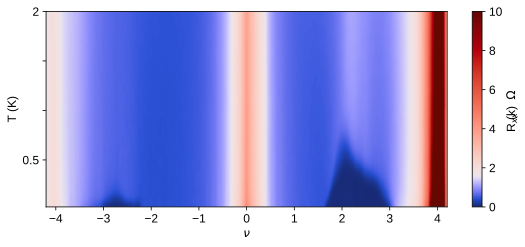

In [16]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.025, 10, 600)
R3534Tint = R3534Tfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534Tint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=1.6, vmin=0, vmax=10), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')
plt.ylim((0.025, 2))
plt.yticks([0.5, 1, 1.5, 2], [0.5, '', '', 2])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

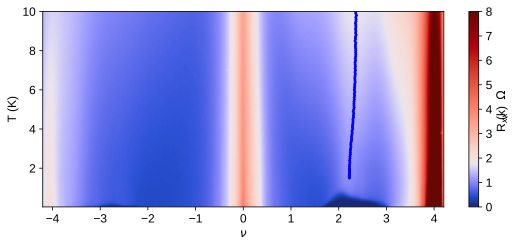

In [17]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.025, 10, 600)
R3534Tint = R3534Tfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534Tint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=1.8, vmin=0, vmax=8), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')
plt.ylim((0.025, 10))

quadpad = 12
peaknu_half_Tsweep = np.zeros(len(temps))
peaknu_half_Tsweep_2 = np.zeros(len(temps))
peakT_half= np.zeros(len(temps))
for i in range(30, len(temps)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 390:450], 2), prominence=0.8, width=10)
    if len(peaks) == 0:
        peaknu_half_Tsweep[i] = np.nan   
        peaknu_half_Tsweep_2[i] = np.nan
        peakT_half[i] = np.nan
    else:
        pind = 390 + peaks[0]
        peaknu_half_Tsweep[i] = nugate3534[pind]
        #plt.plot(peaknu_half_Tsweep[i], temps[i], ".", color = 'green', markersize = 5)
        peakT_half[i] = temps[i]
        theta = np.polyfit(nugate3534[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_Tsweep_2[i] = nu0
        plt.plot(peaknu_half_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)       


#plt.yticks([10, 20, 30, 10], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

(0.025, 25.0)

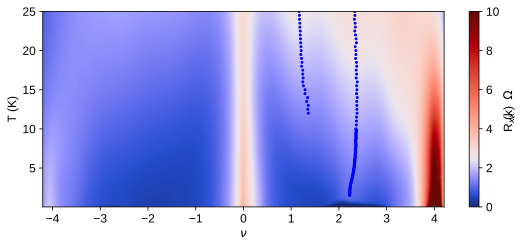

In [18]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.025, 40, 600)
R3534Tint = R3534Tfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534Tint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=2.5, vmin=0, vmax=10), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

quadpadq = 12
peaknu_quarter_Tsweep = np.zeros(len(temps))
peaknu_quarter_Tsweep_2 = np.zeros(len(temps))
peakT_quarter= np.zeros(len(temps))
for i in range(70, len(temps)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 320:380], 2), prominence=0.1, width=5)
    if len(peaks) == 0:
        peaknu_quarter_Tsweep[i] = np.nan   
        peaknu_quarter_Tsweep_2[i] = np.nan
        peakT_quarter[i] = np.nan
    else:
        pind = 320 + peaks[0]
        peaknu_quarter_Tsweep[i] = nugate3534[pind]
        #plt.plot(peaknu_quarter_Tsweep[i], temps[i], ".", color = 'green', markersize = 4)
        peakT_quarter[i] = temps[i]
        theta = np.polyfit(nugate3534[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R3534[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_quarter_Tsweep_2[i] = nu0
        plt.plot(peaknu_quarter_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)  

quadpad = 12
peaknu_half_Tsweep = np.zeros(len(temps))
peaknu_half_Tsweep_2 = np.zeros(len(temps))
peakT_half= np.zeros(len(temps))
for i in range(30, len(temps)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 390:450], 2), prominence=0.8, width=10)
    if len(peaks) == 0:
        peaknu_half_Tsweep[i] = np.nan   
        peaknu_half_Tsweep_2[i] = np.nan
        peakT_half[i] = np.nan
    else:
        pind = 390 + peaks[0]
        peaknu_half_Tsweep[i] = nugate3534[pind]
        #plt.plot(peaknu_half_Tsweep[i], temps[i], ".", color = 'green', markersize = 4)
        peakT_half[i] = temps[i]
        theta = np.polyfit(nugate3534[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_Tsweep_2[i] = nu0
        plt.plot(peaknu_half_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)  

plt.ylim((0.025, 25))
#plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

Line plots

In [19]:
temps[90]

7.0

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

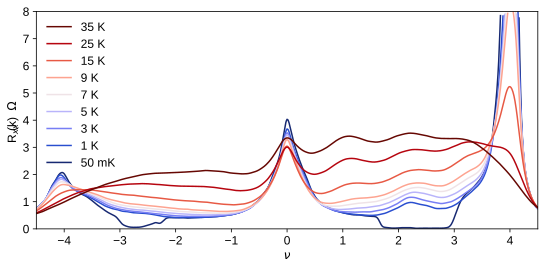

In [20]:
plt.figure(figsize=(9, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

xmin, xmax = -4.5, 4.5
ymin, ymax = 0, 8

#interpolate so that the lines work well
xpts = np.linspace(-4.5, 4.5, 2001)

R3534_pts = np.zeros((R3534.shape[0], len(xpts)))
for i in range(R3534.shape[0]):
    R3534_pts[i, :] = np.interp(xpts, nugate3534, gaussian_filter(R3534[i, :], 2)/1000)

lines = []
lines.append(plt.plot(xpts, np.ma.masked_outside(R3534_pts[1, :], ymin, ymax), label='{} K'.format(temps[1]), color = cs[0]))
lines.append(plt.plot(xpts, np.ma.masked_outside(R3534_pts[20, :], ymin, ymax), label='{} K'.format(temps[20]), color = cs[1]))

for i in range(2, 9):
    indx=i*20 + 10
    lines.append(plt.plot(xpts, np.ma.masked_outside(R3534_pts[indx, :], ymin, ymax), label='{} K'.format(temps[indx]), color = cs[i]))

lines = [l[0] for l in lines]
plt.legend(lines[::-1], ['50 mK', '1 K', '3 K', '5 K', '7 K', '9 K', '15 K', '25 K', '35 K'][::-1], frameon=False)
# plt.legend(frameon=False)
plt.xlim(xmin ,xmax)
plt.ylim(ymin, ymax)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

# plt.savefig(figfile + 'S3_Tlineplots.svg', dpi=300, bbox_inches='tight')

## deviceS3, 0.88$^\circ$ 5.5T

In [21]:
dtemp_5p5T_1 = qc.load_data('data/2020-09-27/#003_S3_865_35-34_830_34-33_8302_40-41_3nA_D0_5p5T_gateTsweepto1K_14-31-18')
dtemp_5p5T_2 = qc.load_data('data/2020-09-27/#004_S3_865_35-34_830_34-33_8302_40-41_3nA_D0_5p5T_gateTsweep1p05to1p4K_19-35-42')
dtemp_5p5T_3 = qc.load_data('data/2020-09-27/#005_S3_865_35-34_830_34-33_8302_40-41_3nA_D0_5p5T_gateTsweep1p45to2K_21-37-41')
dtemp_5p5T_4 = qc.load_data('data/2020-09-28/#001_S3_865_35-34_830_34-33_8302_40-41_3nA_D0_5p5T_gateTsweep2p1to10K_00-47-59')
dtemp_5p5T_5 = qc.load_data('data/2020-09-28/#002_S3_865_35-34_830_34-33_8302_40-41_3nA_D0_5p5T_gateTsweep10p5to25K_21-05-33')

In [22]:
temps_5p5T = np.concatenate((dtemp_5p5T_1.triton_pid_setpoint_set, dtemp_5p5T_2.triton_pid_setpoint_set[:], dtemp_5p5T_3.triton_pid_setpoint_set, dtemp_5p5T_4.triton_pid_setpoint_set[:], dtemp_5p5T_5.triton_pid_setpoint_set))
tgate_5p5T = dtemp_5p5T_1.zeroDparam_set[0,:]
R3534_5p5T = np.vstack((npd.Rxxfromdata(dtemp_5p5T_1, 3e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5p5T_2, 3e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5p5T_3, 3e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5p5T_4, 3e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5p5T_5, 3e-9, 'lockin865')))

In [23]:
Vgatefull3534 = 2.35
V03534 = -0.79

In [24]:
nugate3534_5p5T = np.interp(tgate_5p5T, [V03534 - Vgatefull3534*6/4, V03534 + Vgatefull3534*6/4], [-6, 6])
R3534Tfunc = RectBivariateSpline(nugate3534_5p5T, temps_5p5T, R3534_5p5T.T, kx=1, ky=1)

(0.025, 25)

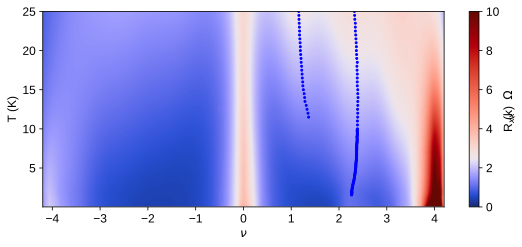

In [25]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.05, 40, 600)
R3534T_5p5T_int = R3534Tfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534T_5p5T_int, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=2.5, vmin=0, vmax=10), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

quadpadq = 12
peaknu_quarter_Tsweep_5p5T = np.zeros(len(temps_5p5T))
peaknu_quarter_Tsweep_5p5T_2 = np.zeros(len(temps_5p5T))
peakT_quarter_5p5T= np.zeros(len(temps_5p5T))
for i in range(70, len(temps_5p5T)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534_5p5T[i, 320:380], 2), prominence=0.1, width=5)
    if len(peaks) == 0:
        peaknu_quarter_Tsweep_5p5T[i] = np.nan   
        peaknu_quarter_Tsweep_5p5T_2[i] = np.nan
        peakT_quarter_5p5T[i] = np.nan
    else:
        pind = 320 + peaks[0]
        peaknu_quarter_Tsweep_5p5T[i] = nugate3534_5p5T[pind]
        #plt.plot(peaknu_quarter_Tsweep_5p5T[i], temps_5p5T[i], ".", color = 'green', markersize = 4)
        peakT_quarter_5p5T[i] = temps_5p5T[i]
        theta = np.polyfit(nugate3534_5p5T[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R3534_5p5T[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_quarter_Tsweep_5p5T_2[i] = nu0
        plt.plot(peaknu_quarter_Tsweep_5p5T_2[i], temps_5p5T[i], '.', color='blue', markersize = 4)  

quadpad = 12
peaknu_half_Tsweep_5p5T = np.zeros(len(temps_5p5T))
peaknu_half_Tsweep_5p5T_2 = np.zeros(len(temps_5p5T))
peakT_half_5p5T= np.zeros(len(temps_5p5T))
for i in range(30, len(temps_5p5T)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534_5p5T[i, 390:450], 2), prominence=0.8, width=10)
    if len(peaks) == 0:
        peaknu_half_Tsweep_5p5T[i] = np.nan   
        peaknu_half_Tsweep_5p5T_2[i] = np.nan
        peakT_half_5p5T[i] = np.nan
    else:
        pind = 390 + peaks[0]
        peaknu_half_Tsweep_5p5T[i] = nugate3534_5p5T[pind]
        #plt.plot(peaknu_half_Tsweep_5p5T[i], temps_5p5T[i], ".", color = 'green', markersize = 4)
        peakT_half_5p5T[i] = temps_5p5T[i]
        theta = np.polyfit(nugate3534_5p5T[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534_5p5T[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_Tsweep_5p5T_2[i] = nu0
        plt.plot(peaknu_half_Tsweep_5p5T_2[i], temps_5p5T[i], '.', color='blue', markersize = 4)  

plt.ylim((0.025, 25))
#plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

## deviceS3, 0.88$^\circ$ 8T

In [26]:
dtemp_8T_1 = qc.load_data('data/2020-09-25/#002_S3_865_35-34_830_34-33_8302_40-41_3nA_D0_7p998T_gateTsweepto1K_13-02-32')
dtemp_8T_2 = qc.load_data('data/2020-09-25/#003_S3_865_35-34_830_34-33_8302_40-41_3nA_D0_7p998T_gateTsweep1p05to1p4K_18-07-21')
dtemp_8T_3 = qc.load_data('data/2020-09-25/#004_S3_865_35-34_830_34-33_8302_40-41_3nA_D0_7p998T_gateTsweep1p45to2K_20-09-15')
dtemp_8T_4 = qc.load_data('data/2020-09-25/#005_S3_865_35-34_830_34-33_8302_40-41_3nA_D0_7p998T_gateTsweep2p1to10K_23-16-04')
dtemp_8T_5 = qc.load_data('data/2020-09-26/#001_S3_865_35-34_830_34-33_8302_40-41_3nA_D0_7p998T_gateTsweep10p5to25K_20-11-07')

In [27]:
temps_8T = np.concatenate((dtemp_8T_1.triton_pid_setpoint_set, dtemp_8T_2.triton_pid_setpoint_set[:], dtemp_8T_3.triton_pid_setpoint_set, dtemp_8T_4.triton_pid_setpoint_set[:], dtemp_8T_5.triton_pid_setpoint_set))
tgate_8T = dtemp_8T_1.zeroDparam_set[0,:]
R3534_8T = np.vstack((npd.Rxxfromdata(dtemp_8T_1, 3e-9, 'lockin865'), npd.Rxxfromdata(dtemp_8T_2, 3e-9, 'lockin865'), npd.Rxxfromdata(dtemp_8T_3, 3e-9, 'lockin865'), npd.Rxxfromdata(dtemp_8T_4, 3e-9, 'lockin865'), npd.Rxxfromdata(dtemp_8T_5, 3e-9, 'lockin865')))

In [28]:
Vgatefull3534 = 2.35
V03534 = -0.79

In [29]:
nugate3534_8T = np.interp(tgate_8T, [V03534 - Vgatefull3534*6/4, V03534 + Vgatefull3534*6/4], [-6, 6])
R3534Tfunc = RectBivariateSpline(nugate3534_8T, temps_8T, R3534_8T.T, kx=1, ky=1)

(0.025, 25)

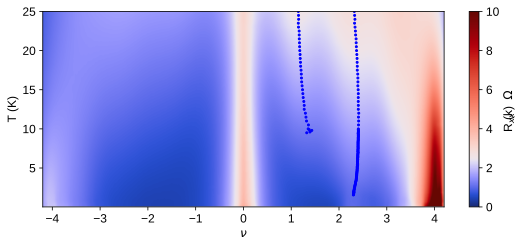

In [30]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.05, 40, 600)
R3534T_8T_int = R3534Tfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534T_8T_int, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=2.5, vmin=0, vmax=10), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

quadpadq = 12
peaknu_quarter_Tsweep_8T = np.zeros(len(temps_8T))
peaknu_quarter_Tsweep_8T_2 = np.zeros(len(temps_8T))
peakT_quarter_8T= np.zeros(len(temps_8T))
for i in range(70, len(temps_8T)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534_8T[i, 320:380], 2), prominence=0.1, width=5)
    if len(peaks) == 0:
        peaknu_quarter_Tsweep_8T[i] = np.nan   
        peaknu_quarter_Tsweep_8T_2[i] = np.nan
        peakT_quarter_8T[i] = np.nan
    else:
        pind = 320 + peaks[0]
        peaknu_quarter_Tsweep_8T[i] = nugate3534_8T[pind]
        #plt.plot(peaknu_quarter_Tsweep_8T[i], temps_8T[i], ".", color = 'green', markersize = 4)
        peakT_quarter_8T[i] = temps_8T[i]
        theta = np.polyfit(nugate3534_8T[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R3534_8T[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_quarter_Tsweep_8T_2[i] = nu0
        plt.plot(peaknu_quarter_Tsweep_8T_2[i], temps_8T[i], '.', color='blue', markersize = 4)  

quadpad = 12
peaknu_half_Tsweep_8T = np.zeros(len(temps_8T))
peaknu_half_Tsweep_8T_2 = np.zeros(len(temps_8T))
peakT_half_8T= np.zeros(len(temps_8T))
for i in range(30, len(temps_8T)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534_8T[i, 390:450], 2), prominence=0.8, width=10)
    if len(peaks) == 0:
        peaknu_half_Tsweep_8T[i] = np.nan   
        peaknu_half_Tsweep_8T_2[i] = np.nan
        peakT_half_8T[i] = np.nan
    else:
        pind = 390 + peaks[0]
        peaknu_half_Tsweep_8T[i] = nugate3534_8T[pind]
        #plt.plot(peaknu_half_Tsweep_8T[i], temps_8T[i], ".", color = 'green', markersize = 4)
        peakT_half_8T[i] = temps_8T[i]
        theta = np.polyfit(nugate3534_8T[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534_8T[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_Tsweep_8T_2[i] = nu0
        plt.plot(peaknu_half_Tsweep_8T_2[i], temps_8T[i], '.', color='blue', markersize = 4)  

plt.ylim((0.025, 25))
#plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

# in plane field dependence

## deviceS3, 0.88$^\circ$

### 2.3K

In [31]:
d_inplane_2p3K_1 = qc.load_data('data/2020-09-12/#003_S3_865_35-34_830_34-33_8302_40-41_5nA_0D_0to6T_fieldgate_2p3K_18-24-48')
d_inplane_2p3K_2 = qc.load_data('data/2020-09-13/#001_S3_865_35-34_830_34-33_8302_40-41_5nA_0D_6p1to8T_fieldgate_2p3K_08-22-27')

In [32]:
Bfield = np.concatenate((d_inplane_2p3K_1.triton_field_set_stable_set, d_inplane_2p3K_2.triton_field_set_stable_set))
Bgate = d_inplane_2p3K_1.zeroDparam_set[0, :]
R3534 = np.vstack((npd.Rxxfromdata(d_inplane_2p3K_1, 5e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_2p3K_2, 5e-9, 'lockin865')))

In [33]:
Vgatefull3534 = 2.35
V03534 = -0.805

In [34]:
nugate3534 = np.interp(Bgate, [V03534 - Vgatefull3534*2/4, V03534 + Vgatefull3534*6/4], [-2, 6])

In [35]:
R3534Bfunc = RectBivariateSpline(nugate3534, Bfield, R3534.T, kx=1, ky=1)

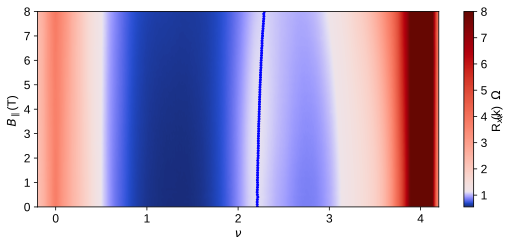

In [36]:
x = np.linspace(-0.2, 4.2, 1000)
y = np.linspace(0, 8, 600)
R3534Bint = R3534Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=1.15, vmin=0.55, vmax=8), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([0, 1, 2, 3, 4], [0, 1, 2 ,3, 4])

quadpad = 12
peaknu_half_B_2p3K = np.zeros(len(Bfield))
peaknu_half_B_2p3K_2 = np.zeros(len(Bfield))
peakB_half_B_2p3K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 250:350], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_half_B_2p3K[i] = np.nan   
        peaknu_half_B_2p3K_2[i] = np.nan
        peakB_half_B_2p3K[i] = np.nan
    else:
        pind = 250 + peaks[0]
        peaknu_half_B_2p3K[i] = nugate3534[pind]
        #plt.plot(peaknu_half_B_2p3K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_half_B_2p3K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_B_2p3K_2[i] = nu0
        plt.plot(peaknu_half_B_2p3K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

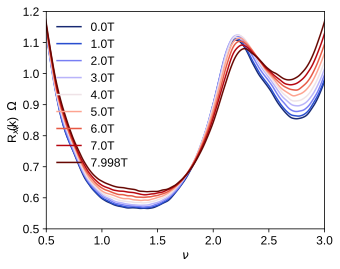

In [37]:
plt.figure(figsize=(5, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate3534[:], gaussian_filter(R3534[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(0.5,3)
plt.ylim(0.5,1.2)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 5K

In [38]:
d_inplane_5K_1 = qc.load_data('data/2020-09-08/#002_S3_865_35-34_830_34-33_8302_40-41_3nA_0D_0to5T_fieldgate_5K_10-37-35')
d_inplane_5K_2 = qc.load_data('data/2020-09-08/#003_S3_865_35-34_830_34-33_8302_40-41_3nA_0D_5p1to8T_fieldgate_5K_22-39-14')

In [39]:
Bfield = np.concatenate((d_inplane_5K_1.triton_field_set_stable_set, d_inplane_5K_2.triton_field_set_stable_set))
Bgate = d_inplane_5K_1.zeroDparam_set[0, :]
R3534 = np.vstack((npd.Rxxfromdata(d_inplane_5K_1, 3e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_5K_2, 3e-9, 'lockin865')))

In [40]:
Vgatefull3534 = 2.35
V03534 = -0.805

In [41]:
nugate3534 = np.interp(Bgate, [V03534 - Vgatefull3534*2/4, V03534 + Vgatefull3534*6/4], [-2, 6])

In [42]:
R3534Bfunc = RectBivariateSpline(nugate3534, Bfield, R3534.T, kx=1, ky=1)

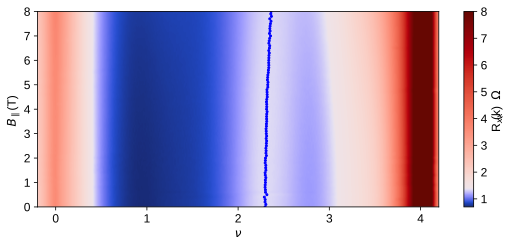

In [43]:
x = np.linspace(-0.2, 4.2, 1000)
y = np.linspace(0, 8, 600)
R3534Bint = R3534Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=1.4, vmin=0.7, vmax=8), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([0, 1, 2, 3, 4], [0, 1, 2 ,3, 4])

quadpad = 12
peaknu_half_B_5K = np.zeros(len(Bfield))
peaknu_half_B_5K_2 = np.zeros(len(Bfield))
peakB_half_B_5K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 250:350], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_half_B_5K[i] = np.nan   
        peaknu_half_B_5K_2[i] = np.nan
        peakB_half_B_5K[i] = np.nan
    else:
        pind = 250 + peaks[0]
        peaknu_half_B_5K[i] = nugate3534[pind]
        #plt.plot(peaknu_half_B_5K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_half_B_5K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_B_5K_2[i] = nu0
        plt.plot(peaknu_half_B_5K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

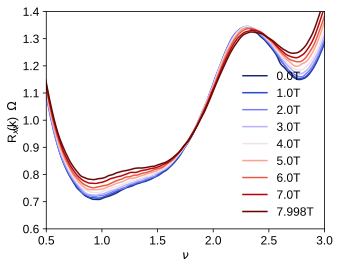

In [44]:
plt.figure(figsize=(5, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate3534[:], gaussian_filter(R3534[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(0.5,3)
plt.ylim(0.6,1.4)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 7.5K

In [45]:
d_inplane_7p5K_1 = qc.load_data('data/2020-09-13/#002_S3_865_35-34_830_34-33_8302_40-41_5nA_0D_8to6p1T_fieldgate_7p5K_18-11-14')
d_inplane_7p5K_2 = qc.load_data('data/2020-09-14/#001_S3_865_35-34_830_34-33_8302_40-41_5nA_0D_6to0T_fieldgate_7p5K_03-42-53')

In [46]:
Bfield = np.concatenate((d_inplane_7p5K_1.triton_field_set_stable_set, d_inplane_7p5K_2.triton_field_set_stable_set))
Bgate = d_inplane_7p5K_1.zeroDparam_set[0, :]
R3534 = np.vstack((npd.Rxxfromdata(d_inplane_7p5K_1, 5e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_7p5K_2, 5e-9, 'lockin865')))

In [47]:
Bfield = Bfield[::-1]
R3534 = np.flip(R3534, axis=0)

In [48]:
Vgatefull3534 = 2.35
V03534 = -0.805

In [49]:
nugate3534 = np.interp(Bgate, [V03534 - Vgatefull3534*2/4, V03534 + Vgatefull3534*6/4], [-2, 6])
R3534Bfunc = RectBivariateSpline(nugate3534, Bfield, R3534.T, kx=1, ky=1)

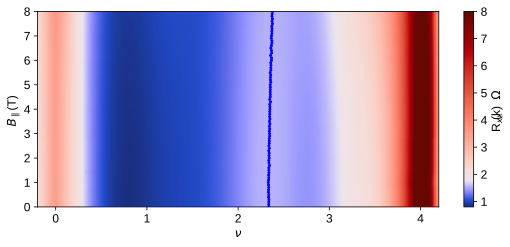

In [50]:
x = np.linspace(-0.2, 4.2, 1000)
y = np.linspace(0, 8, 600)
R3534Bint = R3534Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=1.8, vmin=0.8, vmax=8), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([0, 1, 2, 3, 4], [0, 1, 2 ,3, 4])

quadpad = 12
peaknu_half_B_7p5K = np.zeros(len(Bfield))
peaknu_half_B_7p5K_2 = np.zeros(len(Bfield))
peakB_half_B_7p5K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 250:350], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_half_B_7p5K[i] = np.nan   
        peaknu_half_B_7p5K_2[i] = np.nan
        peakB_half_B_7p5K[i] = np.nan
    else:
        pind = 250 + peaks[0]
        peaknu_half_B_7p5K[i] = nugate3534[pind]
        #plt.plot(peaknu_half_B_7p5K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_half_B_7p5K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_B_7p5K_2[i] = nu0
        plt.plot(peaknu_half_B_7p5K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

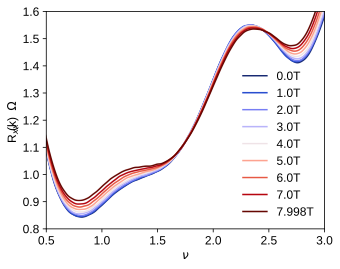

In [51]:
plt.figure(figsize=(5, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate3534[:], gaussian_filter(R3534[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(0.5,3)
plt.ylim(0.8,1.6)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 12K

In [52]:
d_inplane_12K_1 = qc.load_data('data/2020-09-09/#004_S3_865_35-34_830_34-33_8302_40-41_5nA_0D_5p1to8T_fieldgate_12K_13-37-45')
d_inplane_12K_2 = qc.load_data('data/2020-09-09/#005_S3_865_35-34_830_34-33_8302_40-41_5nA_0D_6to0T_fieldgate_12K_23-09-21')

In [53]:
Bfield = np.concatenate((d_inplane_12K_1.triton_field_set_stable_set, d_inplane_12K_2.triton_field_set_stable_set))
Bgate = d_inplane_12K_1.zeroDparam_set[0, :]
R3534 = np.vstack((npd.Rxxfromdata(d_inplane_12K_1, 5e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_12K_2, 5e-9, 'lockin865')))

In [54]:
Bfield = Bfield[::-1]
R3534 = np.flip(R3534, axis=0)

In [55]:
Vgatefull3534 = 2.35
V03534 = -0.805

In [56]:
nugate3534 = np.interp(Bgate, [V03534 - Vgatefull3534*2/4, V03534 + Vgatefull3534*6/4], [-2, 6])
R3534Bfunc = RectBivariateSpline(nugate3534, Bfield, R3534.T, kx=1, ky=1)

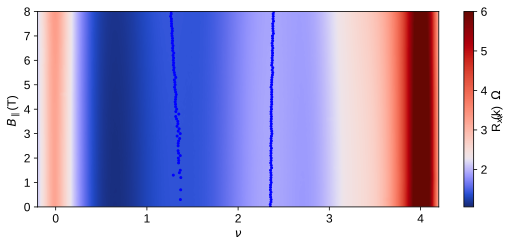

In [57]:
x = np.linspace(-0.2, 4.2, 1000)
y = np.linspace(0, 8, 600)
R3534Bint = R3534Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=2.3, vmin=1.05, vmax=6), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([0, 1, 2, 3, 4], [0, 1, 2 ,3, 4])

quadpadq = 12
peaknu_quarter_B_12K = np.zeros(len(Bfield))
peaknu_quarter_B_12K_2 = np.zeros(len(Bfield))
peakB_quarter_B_12K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 140:260], 2), prominence=0.1, width=8)
    if len(peaks) == 0:
        peaknu_quarter_B_12K[i] = np.nan   
        peaknu_quarter_B_12K_2[i] = np.nan
        peakB_quarter_B_12K[i] = np.nan
    else:
        pind = 140 + peaks[0]
        peaknu_quarter_B_12K[i] = nugate3534[pind]
        #plt.plot(peaknu_quarter_B_12K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_quarter_B_12K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R3534[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_quarter_B_12K_2[i] = nu0
        plt.plot(peaknu_quarter_B_12K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 12
peaknu_half_B_12K = np.zeros(len(Bfield))
peaknu_half_B_12K_2 = np.zeros(len(Bfield))
peakB_half_B_12K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 250:350], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_half_B_12K[i] = np.nan   
        peaknu_half_B_12K_2[i] = np.nan
        peakB_half_B_12K[i] = np.nan
    else:
        pind = 250 + peaks[0]
        peaknu_half_B_12K[i] = nugate3534[pind]
        #plt.plot(peaknu_half_B_12K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_half_B_12K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_B_12K_2[i] = nu0
        plt.plot(peaknu_half_B_12K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

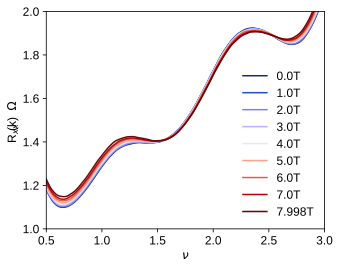

In [58]:
plt.figure(figsize=(5, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate3534[:], gaussian_filter(R3534[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(0.5,3)
plt.ylim(1,2)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 16K

In [59]:
d_inplane_16K_1 = qc.load_data('data/2020-09-10/#001_S3_865_35-34_830_34-33_8302_40-41_5nA_0D_6to0T_fieldgate_16K_13-56-19')
d_inplane_16K_2 = qc.load_data('data/2020-09-11/#001_S3_865_35-34_830_34-33_8302_40-41_5nA_0D_6p1to8T_fieldgate_16K_03-57-04')

In [60]:
Bfield = np.concatenate((d_inplane_16K_1.triton_field_set_stable_set, d_inplane_16K_2.triton_field_set_stable_set))
Bgate = d_inplane_16K_1.zeroDparam_set[0, :]
R3534 = np.vstack((npd.Rxxfromdata(d_inplane_16K_1, 5e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_16K_2, 5e-9, 'lockin865')))

In [61]:
Vgatefull3534 = 2.35
V03534 = -0.805

In [62]:
nugate3534 = np.interp(Bgate, [V03534 - Vgatefull3534*2/4, V03534 + Vgatefull3534*6/4], [-2, 6])
R3534Bfunc = RectBivariateSpline(nugate3534, Bfield, R3534.T, kx=1, ky=1)

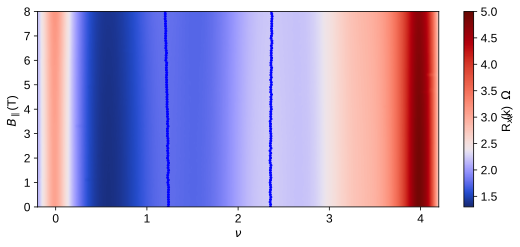

In [63]:
x = np.linspace(-0.2, 4.2, 1000)
y = np.linspace(0, 8, 600)
R3534Bint = R3534Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=2.4, vmin=1.3, vmax=5), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([0, 1, 2, 3, 4], [0, 1, 2 ,3, 4])

quadpadq = 12
peaknu_quarter_B_16K = np.zeros(len(Bfield))
peaknu_quarter_B_16K_2 = np.zeros(len(Bfield))
peakB_quarter_B_16K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 140:260], 2), prominence=0.1, width=8)
    if len(peaks) == 0:
        peaknu_quarter_B_16K[i] = np.nan   
        peaknu_quarter_B_16K_2[i] = np.nan
        peakB_quarter_B_16K[i] = np.nan
    else:
        pind = 140 + peaks[0]
        peaknu_quarter_B_16K[i] = nugate3534[pind]
        #plt.plot(peaknu_quarter_B_16K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_quarter_B_16K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R3534[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_quarter_B_16K_2[i] = nu0
        plt.plot(peaknu_quarter_B_16K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 12
peaknu_half_B_16K = np.zeros(len(Bfield))
peaknu_half_B_16K_2 = np.zeros(len(Bfield))
peakB_half_B_16K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 250:350], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_half_B_16K[i] = np.nan   
        peaknu_half_B_16K_2[i] = np.nan
        peakB_half_B_16K[i] = np.nan
    else:
        pind = 250 + peaks[0]
        peaknu_half_B_16K[i] = nugate3534[pind]
        #plt.plot(peaknu_half_B_16K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_half_B_16K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_B_16K_2[i] = nu0
        plt.plot(peaknu_half_B_16K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

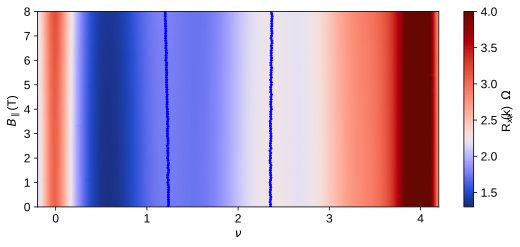

In [64]:
x = np.linspace(-0.2, 4.2, 1000)
y = np.linspace(0, 8, 600)
R3534Bint = R3534Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=2.23, vmin=1.3, vmax=4), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([0, 1, 2, 3, 4], [0, 1, 2 ,3, 4])

quadpadq = 12
peaknu_quarter_B_16K = np.zeros(len(Bfield))
peaknu_quarter_B_16K_2 = np.zeros(len(Bfield))
peakB_quarter_B_16K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 140:260], 2), prominence=0.1, width=8)
    if len(peaks) == 0:
        peaknu_quarter_B_16K[i] = np.nan   
        peaknu_quarter_B_16K_2[i] = np.nan
        peakB_quarter_B_16K[i] = np.nan
    else:
        pind = 140 + peaks[0]
        peaknu_quarter_B_16K[i] = nugate3534[pind]
        #plt.plot(peaknu_quarter_B_16K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_quarter_B_16K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R3534[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_quarter_B_16K_2[i] = nu0
        plt.plot(peaknu_quarter_B_16K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 12
peaknu_half_B_16K = np.zeros(len(Bfield))
peaknu_half_B_16K_2 = np.zeros(len(Bfield))
peakB_half_B_16K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 250:350], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_half_B_16K[i] = np.nan   
        peaknu_half_B_16K_2[i] = np.nan
        peakB_half_B_16K[i] = np.nan
    else:
        pind = 250 + peaks[0]
        peaknu_half_B_16K[i] = nugate3534[pind]
        #plt.plot(peaknu_half_B_16K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_half_B_16K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_B_16K_2[i] = nu0
        plt.plot(peaknu_half_B_16K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

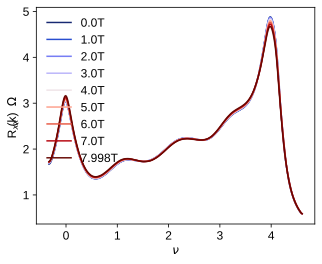

In [65]:
plt.figure(figsize=(5, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate3534[:], gaussian_filter(R3534[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
#plt.xlim(0.5,3)
#plt.ylim(1.3,2.3)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 22K

In [66]:
d_inplane_22K_1 = qc.load_data('data/2020-09-11/#002_S3_865_35-34_830_34-33_8302_40-41_5nA_0D_8to6p1T_fieldgate_22K_13-57-29')
d_inplane_22K_2 = qc.load_data('data/2020-09-11/#003_S3_865_35-34_830_34-33_8302_40-41_5nA_0D_6to0T_fieldgate_22K_23-30-47')

In [67]:
Bfield = np.concatenate((d_inplane_22K_1.triton_field_set_stable_set, d_inplane_22K_2.triton_field_set_stable_set))
Bgate = d_inplane_22K_1.zeroDparam_set[0, :]
R3534 = np.vstack((npd.Rxxfromdata(d_inplane_22K_1, 5e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_22K_2, 5e-9, 'lockin865')))

In [68]:
Bfield = Bfield[::-1]
R3534 = np.flip(R3534, axis=0)

In [69]:
Vgatefull3534 = 2.35
V03534 = -0.805

In [70]:
nugate3534 = np.interp(Bgate, [V03534 - Vgatefull3534*2/4, V03534 + Vgatefull3534*6/4], [-2, 6])
R3534Bfunc = RectBivariateSpline(nugate3534, Bfield, R3534.T, kx=1, ky=1)

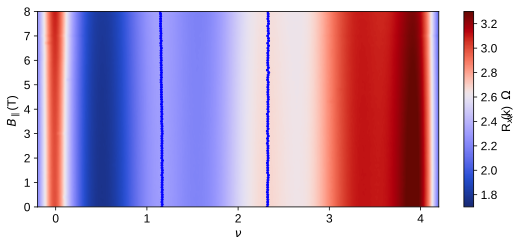

In [71]:
x = np.linspace(-0.2, 4.2, 1000)
y = np.linspace(0, 8, 600)
R3534Bint = R3534Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R3534Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=2.63, vmin=1.7, vmax=3.3), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([0, 1, 2, 3, 4], [0, 1, 2 ,3, 4])

quadpadq = 12
peaknu_quarter_B_22K = np.zeros(len(Bfield))
peaknu_quarter_B_22K_2 = np.zeros(len(Bfield))
peakB_quarter_B_22K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 140:260], 2), prominence=0.1, width=8)
    if len(peaks) == 0:
        peaknu_quarter_B_22K[i] = np.nan   
        peaknu_quarter_B_22K_2[i] = np.nan
        peakB_quarter_B_22K[i] = np.nan
    else:
        pind = 140 + peaks[0]
        peaknu_quarter_B_22K[i] = nugate3534[pind]
        #plt.plot(peaknu_quarter_B_22K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_quarter_B_22K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R3534[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_quarter_B_22K_2[i] = nu0
        plt.plot(peaknu_quarter_B_22K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 12
peaknu_half_B_22K = np.zeros(len(Bfield))
peaknu_half_B_22K_2 = np.zeros(len(Bfield))
peakB_half_B_22K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R3534[i, 250:350], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_half_B_22K[i] = np.nan   
        peaknu_half_B_22K_2[i] = np.nan
        peakB_half_B_22K[i] = np.nan
    else:
        pind = 250 + peaks[0]
        peaknu_half_B_22K[i] = nugate3534[pind]
        #plt.plot(peaknu_half_B_22K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_half_B_22K[i] = Bfield[i]
        theta = np.polyfit(nugate3534[pind-quadpad:pind+quadpad+1], gaussian_filter(R3534[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_half_B_22K_2[i] = nu0
        plt.plot(peaknu_half_B_22K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

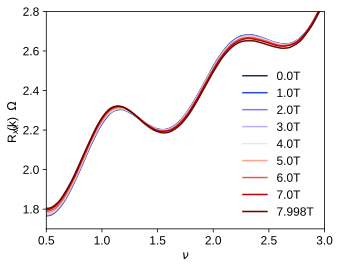

In [72]:
plt.figure(figsize=(5, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate3534[:], gaussian_filter(R3534[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(0.5,3)
plt.ylim(1.7,2.8)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

## S3 T and B dependence half filling peaks together

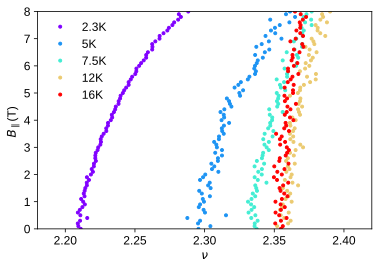

In [73]:
plt.figure(figsize=(6, 4))

N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

plt.plot(peaknu_half_B_2p3K_2[:], Bfield[:], ".", color = cs[int((2.3-2.3)/(16-2.3)*999)], label = '2.3K') 
plt.plot(peaknu_half_B_5K_2[:], Bfield[:], ".", color = cs[int((5-2.3)/(16-2.3)*999)],  label = '5K') 
plt.plot(peaknu_half_B_7p5K_2[:], Bfield[:], ".", color = cs[int((7.5-2.3)/(16-2.3)*999)],  label = '7.5K') 
plt.plot(peaknu_half_B_12K_2[:], Bfield[:], ".", color = cs[int((12-2.3)/(16-2.3)*999)],  label = '12K') 
plt.plot(peaknu_half_B_16K_2[:], Bfield[:], ".", color = cs[int((16-2.3)/(16-2.3)*999)],  label = '16K') 
#plt.plot(peaknu_half_B_22K_2[:], Bfield[:], ".", color = 'pink',  label = '22K') 


plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xlim(2.18, 2.42)
plt.ylim(0,8)
plt.axis()
plt.legend(frameon=False)

In [74]:
temps_S3_3D_0T = np.zeros(133-43)
peaknu_half_Tsweep_S3_3D_0T = np.zeros(133-43)
for i in range(133-43):
    temps_S3_3D_0T[i] =  temps[43+i]
    peaknu_half_Tsweep_S3_3D_0T[i] =  peaknu_half_Tsweep_2[43+i]

In [75]:
temps_S3_3D_5p5T = np.zeros(132-42)
peaknu_half_Tsweep_S3_3D_5p5T = np.zeros(132-42)
for i in range(132-42):
    temps_S3_3D_5p5T[i] =  temps_5p5T[42+i]
    peaknu_half_Tsweep_S3_3D_5p5T[i] =  peaknu_half_Tsweep_5p5T_2[42+i]

In [76]:
temps_S3_3D_8T = np.zeros(132-42)
peaknu_half_Tsweep_S3_3D_8T = np.zeros(132-42)
for i in range(132-42):
    temps_S3_3D_8T[i] =  temps_8T[42+i]
    peaknu_half_Tsweep_S3_3D_8T[i] =  peaknu_half_Tsweep_8T_2[42+i]

half filling T dependence peaks need to offset 0.02 filling to match the B dependence peaks

(2.2, 2.4)

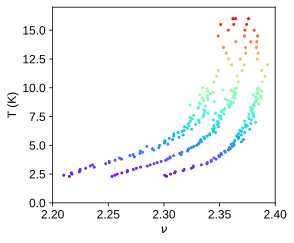

In [77]:
plt.figure(figsize=(4, 3.6))

for i in range(133-43):
    plt.plot(peaknu_half_Tsweep_S3_3D_0T[i]-0.02, temps_S3_3D_0T[i], '.', color = cs[int((temps_S3_3D_0T[i]-2.3)/(16-2.3)*999)], markersize = 4)
    
for i in range(132-42):
    plt.plot(peaknu_half_Tsweep_S3_3D_5p5T[i]-0.02, temps_S3_3D_5p5T[i], '.', color = cs[int((temps_S3_3D_5p5T[i]-2.3)/(16-2.3)*999)], markersize = 4) 
    
for i in range(132-42):
    plt.plot(peaknu_half_Tsweep_S3_3D_8T[i]-0.02, temps_S3_3D_8T[i], '.', color = cs[int((temps_S3_3D_8T[i]-2.3)/(16-2.3)*999)], markersize = 4)  

plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')
plt.ylim((0, 17))
plt.xlim((2.2, 2.4))
#plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

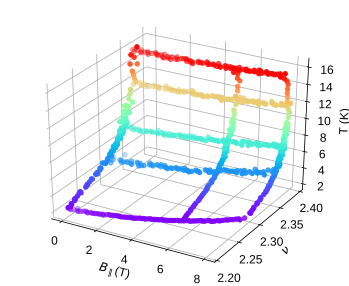

In [78]:
fig = plt.figure(figsize=(6, 5))
ax = plt.axes(projection='3d')

ax.scatter3D(Bfield[:], peaknu_half_B_2p3K_2[:], np.full((81), 2.3), ".",color = cs[int((2.3-2.3)/(16-2.3)*999)]);
ax.scatter3D(Bfield[:], peaknu_half_B_5K_2[:], np.full((81), 5), ".",color = cs[int((5-2.3)/(16-2.3)*999)]);
ax.scatter3D(Bfield[:], peaknu_half_B_7p5K_2[:], np.full((81), 7.5), ".",color = cs[int((7.5-2.3)/(16-2.3)*999)]);
ax.scatter3D(Bfield[:], peaknu_half_B_12K_2[:], np.full((81), 12), ".",color = cs[int((12-2.3)/(16-2.3)*999)]);
ax.scatter3D(Bfield[:], peaknu_half_B_16K_2[:], np.full((81), 16), ".",color = cs[int((16-2.3)/(16-2.3)*999)]);


for i in range(133-43):
    ax.scatter3D(Bfield[0], peaknu_half_Tsweep_S3_3D_0T[i]-0.02, temps_S3_3D_0T[i], '.', color = cs[int((temps_S3_3D_0T[i]-2.3)/(16-2.3)*999)]) 
    
for i in range(132-42):
    ax.scatter3D(Bfield[55], peaknu_half_Tsweep_S3_3D_5p5T[i]-0.02, temps_S3_3D_5p5T[i], '.', color = cs[int((temps_S3_3D_5p5T[i]-2.3)/(16-2.3)*999)])
    
for i in range(132-42):
    ax.scatter3D(Bfield[80], peaknu_half_Tsweep_S3_3D_8T[i]-0.02, temps_S3_3D_8T[i], '.', color = cs[int((temps_S3_3D_8T[i]-2.3)/(16-2.3)*999)]) 




ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

ax.set_xlabel(r'$B_{\parallel}$ (T)')
ax.set_ylabel(r'$\nu$')
ax.set_zlabel('T (K)');

ax.set_xticks([0, 2, 4, 6, 8])
ax.set_yticks([2.2, 2.25, 2.3, 2.35, 2.4])

# plt.savefig(figfile + 'S3_0p88_halffilling 3D.svg', dpi=300, bbox_inches='tight')affinity


## S3 half filling peaks entropy fitting

output data and fit with matlab, just use the B field data at different T for fitting

In [221]:
scipy.io.savemat('S3half2p3K.mat', dict(b1=Bfield, S3_halffilling_1=peaknu_half_B_2p3K_2))

In [222]:
scipy.io.savemat('S3half5K.mat', dict(b2=Bfield, S3_halffilling_2=peaknu_half_B_5K_2))

In [223]:
scipy.io.savemat('S3half7p5K.mat', dict(b3=Bfield, S3_halffilling_3=peaknu_half_B_7p5K_2))

In [224]:
scipy.io.savemat('S3half12K.mat', dict(b4=Bfield, S3_halffilling_4=peaknu_half_B_12K_2))

In [225]:
scipy.io.savemat('S3half16K.mat', dict(b5=Bfield, S3_halffilling_5=peaknu_half_B_16K_2))

fitting (2.3 K 5K 7.5K 12K 16K) use the following formula:


$\nu$ =  1 / ( u ) * ( e - ( g ) * T^2 / 2 + T * log ( 2 * cosh ( 0.671713 * B / T ) ) )

where 0.671713 is $\mu_{B}$/$k_{B}$

u = $\mu_{2}$ - $\mu_{1}$

e = $e_{2}$ - $e_{1}$

g = $\gamma_{2}$ - $\gamma_{1}$

with the help of matlab here are the result:

u = 27.8  (25.66, 29.94)

g = 0.04501  (0.04297, 0.04706)

e = 60.21  (55.3, 65.11)

Goodness of fit:

SSE: 0.2279

R-square: 0.7767

Adjusted R-square: 0.7756

RMSE: 0.02381

In [226]:
u = 27.8
e = 60.21
g = 0.04501
def f(T, B):
    return 1/(u)*(e - (g)*T**2 / 2 + 1*T * np.log(2*np.cosh(0.671713*B/T)))

t = np.linspace(2.3, 16, 20)
b = np.linspace(0, 8, 16)

T, B = np.meshgrid(t, b)
Z = f(T, B)

In [227]:
T2 = np.linspace(2.3, 16, 1000)
B2 = np.linspace(0,8,10)

In [228]:
T3 = np.linspace(2.3, 16, 10)
B3 = np.linspace(0,8,1000)

In [235]:
fig = plt.figure(figsize=(5, 5))
# ax = plt.axes(projection='3d')

ax = fig.add_subplot(111, projection='3d')

for i in range(len(B2)):
    for j in range(len(T2)):
        ax.scatter(B2[i], 1/(u)*(e - (g)*T2[j]**2 / 2 + 1*T2[j] * np.log(2*np.cosh(0.671713*B2[i]/T2[j]))), T2[j], '.', color = cs[int((T2[j]-2.3)/(16-2.3)*999)], s=1)
        
for i in range(len(T3)):
    for j in range(len(B3)):
        ax.scatter(B3[j], 1/(u)*(e - (g)*T3[i]**2 / 2 + 1*T3[i] * np.log(2*np.cosh(0.671713*B3[j]/T3[i]))), T3[i], '.', color = cs[int((T3[i]-2.3)/(16-2.3)*999)], s=1)
        


ax.set_xlabel('B (T)')
ax.set_ylabel(r'$\nu$')
ax.set_zlabel('T (K)');

ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

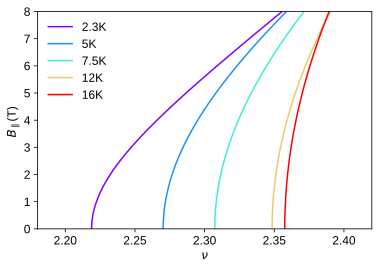

In [236]:
plt.figure(figsize=(6, 4))

N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

plt.plot(1/(u)*(e - (g)*2.3**2 / 2 + 1*2.3 * np.log(2*np.cosh(0.671713*Bfield[:]/2.3))), Bfield[:], color = cs[int((2.3-2.3)/(16-2.3)*999)], label = '2.3K')
plt.plot(1/(u)*(e - (g)*5**2 / 2 + 1*5 * np.log(2*np.cosh(0.671713*Bfield[:]/5))), Bfield[:], color = cs[int((5-2.3)/(16-2.3)*999)], label = '5K')
plt.plot(1/(u)*(e - (g)*7.5**2 / 2 + 1*7.5 * np.log(2*np.cosh(0.671713*Bfield[:]/7.5))), Bfield[:], color = cs[int((7.5-2.3)/(16-2.3)*999)], label = '7.5K')
plt.plot(1/(u)*(e - (g)*12**2 / 2 + 1*12 * np.log(2*np.cosh(0.671713*Bfield[:]/12))), Bfield[:], color = cs[int((12-2.3)/(16-2.3)*999)], label = '12K')
plt.plot(1/(u)*(e - (g)*16**2 / 2 + 1*16 * np.log(2*np.cosh(0.671713*Bfield[:]/16))), Bfield[:], color = cs[int((16-2.3)/(16-2.3)*999)], label = '16K')

plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xlim(2.18, 2.42)
plt.ylim(0,8)
plt.axis()
plt.legend(frameon=False)

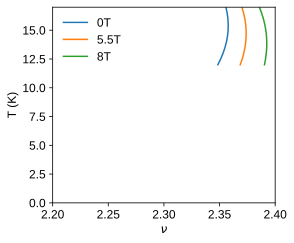

In [237]:
plt.figure(figsize=(4, 3.6))

plt.plot(1/(u)*(e - (g)*temps_S3_3D_0T[:]**2 / 2 + 1*temps_S3_3D_0T[:] * np.log(2*np.cosh(0.671713*0/temps_S3_3D_0T[:]))), temps_S3_3D_0T[:], label = '0T')
plt.plot(1/(u)*(e - (g)*temps_S3_3D_5p5T[:]**2 / 2 + 1*temps_S3_3D_5p5T[:] * np.log(2*np.cosh(0.671713*5.5/temps_S3_3D_5p5T[:]))), temps_S3_3D_5p5T[:], label = '5.5T')
plt.plot(1/(u)*(e - (g)*temps_S3_3D_8T[:]**2 / 2 + 1*temps_S3_3D_8T[:] * np.log(2*np.cosh(0.671713*8/temps_S3_3D_8T[:]))), temps_S3_3D_8T[:], label = '8T')

plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

plt.ylim((0, 17))
plt.xlim((2.2, 2.4))
plt.axis()
plt.legend(frameon=False)

## S3 T and B dependence quarter filling peaks together

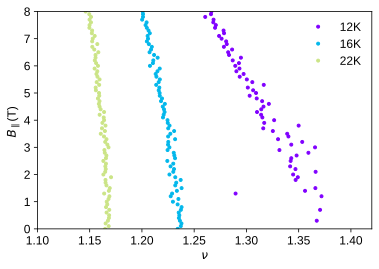

In [253]:
plt.figure(figsize=(6, 4))

N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))
minT, maxT = 12, 27.5
 
plt.plot(peaknu_quarter_B_12K_2[:], Bfield[:], ".", color = cs[int((12-minT)/(maxT-minT)*999)],  label = '12K') 
plt.plot(peaknu_quarter_B_16K_2[:], Bfield[:], ".", color = cs[int((16-minT)/(maxT-minT)*999)],  label = '16K') 
plt.plot(peaknu_quarter_B_22K_2[:], Bfield[:], ".", color = cs[int((22-minT)/(maxT-minT)*999)],  label = '22K') 


plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xlim(1.1, 1.42)
plt.ylim(0,8)
plt.axis()
plt.legend(frameon=False)

In [254]:
temps_S3_3D_0T = np.zeros(145-124)
peaknu_quarter_Tsweep_S3_3D_0T = np.zeros(145-124)
for i in range(145-124):
    temps_S3_3D_0T[i] =  temps[124+i]
    peaknu_quarter_Tsweep_S3_3D_0T[i] =  peaknu_quarter_Tsweep_2[124+i]

In [255]:
temps_S3_3D_0T

array([17.5, 18. , 18.5, 19. , 19.5, 20. , 20.5, 21. , 21.5, 22. , 22.5,
       23. , 23.5, 24. , 24.5, 25. , 25.5, 26. , 26.5, 27. , 27.5])

In [256]:
temps_S3_3D_5p5T = np.zeros(144-123)
peaknu_quarter_Tsweep_S3_3D_5p5T = np.zeros(144-123)
for i in range(144-123):
    temps_S3_3D_5p5T[i] =  temps_5p5T[123+i]
    peaknu_quarter_Tsweep_S3_3D_5p5T[i] =  peaknu_quarter_Tsweep_5p5T_2[123+i]

In [257]:
temps_S3_3D_5p5T[0]

12.0

In [258]:
temps_S3_3D_8T = np.zeros(144-123)
peaknu_quarter_Tsweep_S3_3D_8T = np.zeros(144-123)
for i in range(144-123):
    temps_S3_3D_8T[i] =  temps_8T[123+i]
    peaknu_quarter_Tsweep_S3_3D_8T[i] =  peaknu_quarter_Tsweep_8T_2[123+i]

In [259]:
temps_S3_3D_8T[0]

12.0

In [260]:
len(temps_S3_3D_0T)

21

In [261]:
temps_S3_3D_0T[145-124-1]

27.5

Text(0, 0.5, 'T (K)')

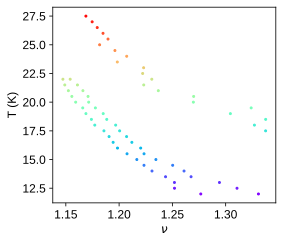

In [262]:
plt.figure(figsize=(4, 3.6))

for i in range(145-124):
    plt.plot(peaknu_quarter_Tsweep_S3_3D_0T[i]-0.02, temps_S3_3D_0T[i], '.', color = cs[int((temps_S3_3D_0T[i]-minT)/(maxT-minT)*999)], markersize = 4)
    
    
for i in range(144-123):
    plt.plot(peaknu_quarter_Tsweep_S3_3D_5p5T[i]-0.02, temps_S3_3D_5p5T[i], '.', color = cs[int((temps_S3_3D_5p5T[i]-minT)/(maxT-minT)*999)], markersize = 4) 
    
for i in range(144-123):
    plt.plot(peaknu_quarter_Tsweep_S3_3D_8T[i]-0.02, temps_S3_3D_8T[i], '.', color = cs[int((temps_S3_3D_8T[i]-minT)/(maxT-minT)*999)], markersize = 4)  

plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')
#plt.ylim((0, 17))
#plt.xlim((2.2, 2.4))
#plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

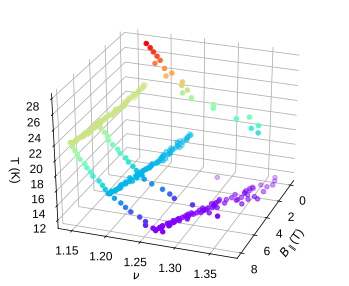

In [267]:
fig = plt.figure(figsize=(6, 5))
ax = plt.axes(projection='3d')

ax.scatter3D(Bfield[:], peaknu_quarter_B_12K_2[:], np.full((81), 12), ".", color = cs[int((12-minT)/(maxT-minT)*999)]);
ax.scatter3D(Bfield[:], peaknu_quarter_B_16K_2[:], np.full((81), 16), ".", color = cs[int((16-minT)/(maxT-minT)*999)]);
ax.scatter3D(Bfield[:], peaknu_quarter_B_22K_2[:], np.full((81), 22), ".", color = cs[int((22-minT)/(maxT-minT)*999)]);

for i in range(145-124):
    ax.scatter3D(Bfield[0], peaknu_quarter_Tsweep_S3_3D_0T[i]-0.02, temps_S3_3D_0T[i], '.', color = cs[int((temps_S3_3D_0T[i]-minT)/(maxT-minT)*999)]) 
    
for i in range(144-123):
    ax.scatter3D(Bfield[55], peaknu_quarter_Tsweep_S3_3D_5p5T[i]-0.02, temps_S3_3D_5p5T[i], '.', color = cs[int((temps_S3_3D_5p5T[i]-minT)/(maxT-minT)*999)])
    
for i in range(144-123):
    ax.scatter3D(Bfield[80], peaknu_quarter_Tsweep_S3_3D_8T[i]-0.02, temps_S3_3D_8T[i], '.', color = cs[int((temps_S3_3D_8T[i]-minT)/(maxT-minT)*999)]) 


ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

ax.set_xlabel(r'$B_{\parallel}$ (T)')
ax.set_ylabel(r'$\nu$')
ax.set_zlabel('T (K)');

ax.set_xticks([0, 2, 4, 6, 8])

ax.view_init(azim=20)
#plt.savefig(figfile + 'S3_0p88_quarterfilling 3D.svg', dpi=300, bbox_inches='tight')

## S3 quarter filling peaks entropy fitting

output data and fit with matlab, just use the B field data at different T for fitting

In [268]:
scipy.io.savemat('S3quarter12K.mat', dict(b1=Bfield, S3_quarterfilling_1=peaknu_quarter_B_12K_2))

In [269]:
scipy.io.savemat('S3quarter16K.mat', dict(b1=Bfield, S3_quarterfilling_2=peaknu_quarter_B_16K_2))

In [270]:
scipy.io.savemat('S3quarter22K.mat', dict(b1=Bfield, S3_quarterfilling_3=peaknu_quarter_B_22K_2))

fitting (12K 16K 22K) use the following formula:


$\nu$ =  1 / ( u ) * ( e - ( g ) * T^2 / 2  T * log ( 2 * cosh ( 0.671713 * B / T ) ) )

where 0.671713 is $\mu_{B}$/$k_{B}$

u = $\mu_{2}$ - $\mu_{1}$

e = $e_{2}$ - $e_{1}$

g = $\gamma_{2}$ - $\gamma_{1}$

with the help of matlab here are the result:

u = 13.61  (12.75, 14.48)

g = -0.02737  (-0.02814, -0.02659)

e = 24.62  (23.45, 25.78)

Goodness of fit:

SSE: 0.03155
  
R-square: 0.9666

Adjusted R-square: 0.9663

RMSE: 0.01179

In [271]:
u = 13.61
e = 24.62
g = -0.02737
def f(T, B):
    return 1/(u)*(e - (g)*T**2 / 2 - 1*T * np.log(2*np.cosh(0.671713*B/T)))

t = np.linspace(12, 22, 20)
b = np.linspace(0, 8, 16)

T, B = np.meshgrid(t, b)
Z = f(T, B)

In [272]:
T2 = np.linspace(12, 22, 1000)
B2 = np.linspace(0,8,10)

In [273]:
T3 = np.linspace(12, 22, 10)
B3 = np.linspace(0,8,1000)

In [274]:
fig = plt.figure(figsize=(5, 5))
ax = plt.axes(projection='3d')

for i in range(len(B2)):
    for j in range(len(T2)):
        ax.scatter(B2[i], 1/(u)*(e - (g)*T2[j]**2 / 2 - 1*T2[j] * np.log(2*np.cosh(0.671713*B2[i]/T2[j]))), T2[j], '.', color = cs[int((T2[j]-12)/(22-12)*999)], s=1)
        
for i in range(len(T3)):
    for j in range(len(B3)):
        ax.scatter(B3[j], 1/(u)*(e - (g)*T3[i]**2 / 2 - 1*T3[i] * np.log(2*np.cosh(0.671713*B3[j]/T3[i]))), T3[i], '.', color = cs[int((T3[i]-12)/(22-12)*999)], s=1)
        


ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

ax.set_xlabel(r'$B_{\parallel}$ (T)')
ax.set_ylabel(r'$\nu$')
ax.set_zlabel('T (K)');

ax.set_xticks([0, 2, 4, 6, 8])

ax.view_init(azim=60)

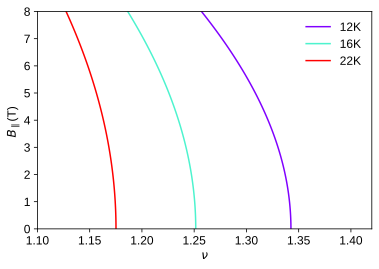

In [277]:
plt.figure(figsize=(6, 4))

N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

plt.plot(1/(u)*(e - (g)*12**2 / 2 - 1*12 * np.log(2*np.cosh(0.671713*Bfield[:]/12))), Bfield[:], color = cs[int((12-12)/(22-12)*999)], label = '12K')
plt.plot(1/(u)*(e - (g)*16**2 / 2 - 1*16 * np.log(2*np.cosh(0.671713*Bfield[:]/16))), Bfield[:], color = cs[int((16-12)/(22-12)*999)], label = '16K')
plt.plot(1/(u)*(e - (g)*22**2 / 2 - 1*22 * np.log(2*np.cosh(0.671713*Bfield[:]/22))), Bfield[:], color = cs[int((22-12)/(22-12)*999)], label = '22K')

plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')

plt.xlim(1.1, 1.42)
plt.ylim(0,8)
plt.axis()
plt.legend(frameon=False)

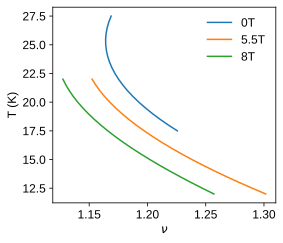

In [278]:
plt.figure(figsize=(4, 3.6))

plt.plot(1/(u)*(e - (g)*temps_S3_3D_0T[:]**2 / 2 - 1*temps_S3_3D_0T[:] * np.log(2*np.cosh(0.671713*0/temps_S3_3D_0T[:]))), temps_S3_3D_0T[:], label = '0T')
plt.plot(1/(u)*(e - (g)*temps_S3_3D_5p5T[:]**2 / 2 - 1*temps_S3_3D_5p5T[:] * np.log(2*np.cosh(0.671713*5.5/temps_S3_3D_5p5T[:]))), temps_S3_3D_5p5T[:], label = '5.5T')
plt.plot(1/(u)*(e - (g)*temps_S3_3D_8T[:]**2 / 2 - 1*temps_S3_3D_8T[:] * np.log(2*np.cosh(0.671713*8/temps_S3_3D_8T[:]))), temps_S3_3D_8T[:], label = '8T')

plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

#plt.ylim((0, 17))
#plt.xlim((2.2, 2.4))
plt.axis()
plt.legend(frameon=False)

# T dependence deviceW3, 1.1$^\circ$

gate for now full filling 7.44, because with 7.64, the electron side half filling seems is smaller than 2, which in principle should not happen

In [92]:
dtemp_1 = qc.load_data('data/2020-10-01/#004_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweepto1K_11-21-17')
dtemp_2 = qc.load_data('data/2020-10-01/#005_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep1p05to1p4K_15-46-08')
dtemp_3 = qc.load_data('data/2020-10-01/#006_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep1p45to2K_17-32-28')
dtemp_4 = qc.load_data('data/2020-10-01/#007_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep2p1to10K_22-01-42')
dtemp_5 = qc.load_data('data/2020-10-02/#001_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep10p5to30K_15-37-29')
dtemp_6 = qc.load_data('data/2020-10-03/#001_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep30p5to40K_01-05-40')

In [93]:
temps = np.concatenate((dtemp_1.triton_pid_setpoint_set, dtemp_2.triton_pid_setpoint_set[:], dtemp_3.triton_pid_setpoint_set, dtemp_4.triton_pid_setpoint_set[:], dtemp_5.triton_pid_setpoint_set, dtemp_6.triton_pid_setpoint_set[:]))
tgate = dtemp_1.srframe_volt_p1_set[0,:]
R0708 = np.vstack((npd.Rxxfromdata(dtemp_1, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_2, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_3, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_4, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_6, 2e-9, 'lockin865')))

In [94]:
Vgatefull0708 = 7.48
V00708 = 0.2

In [95]:
nugate0708 = np.interp(tgate, [V00708 - Vgatefull0708*4/4, V00708 + Vgatefull0708*4/4], [-4, 4])

In [96]:
R0708Tfunc = RectBivariateSpline(nugate0708, temps, R0708.T, kx=1, ky=1)

In [97]:
temps[49]

3.0

(0.05, 40.0)

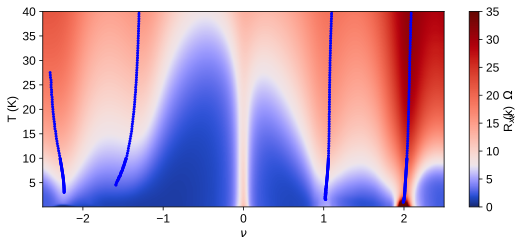

In [98]:
x = np.linspace(-4, 4, 1000)
y = np.linspace(0.025, 40, 600)
R0708Tint = R0708Tfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R0708Tint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=7.5, vmin=0, vmax=35), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)


quadpadq = 12
peaknu_W3_mquarter_Tsweep = np.zeros(len(temps))
peaknu_W3_mquarter_Tsweep_2 = np.zeros(len(temps))
peakT_W3_mquarter= np.zeros(len(temps))
for i in range(57, len(temps)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_Tsweep[i] = np.nan   
        peaknu_W3_mquarter_Tsweep_2[i] = np.nan
        peakT_W3_mquarter[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_Tsweep[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mquarter_Tsweep[i], temps[i], ".", color = 'green', markersize = 4)
        peakT_W3_mquarter[i] = temps[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_Tsweep_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)  

quadpad = 7
peaknu_W3_mhalf_Tsweep = np.zeros(len(temps))
peaknu_W3_mhalf_Tsweep_2 = np.zeros(len(temps))
peakT_W3_mhalf= np.zeros(len(temps))
for i in range(49, len(temps)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_Tsweep[i] = np.nan   
        peaknu_W3_mhalf_Tsweep_2[i] = np.nan
        peakT_W3_mhalf[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_Tsweep[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mhalf_Tsweep[i], temps[i], ".", color = 'green', markersize = 4)
        peakT_W3_mhalf[i] = temps[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_Tsweep_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)  


quadpadq = 12
peaknu_W3_quarter_Tsweep = np.zeros(len(temps))
peaknu_W3_quarter_Tsweep_2 = np.zeros(len(temps))
peakT_W3_quarter= np.zeros(len(temps))
for i in range(30, len(temps)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_Tsweep[i] = np.nan   
        peaknu_W3_quarter_Tsweep_2[i] = np.nan
        peakT_W3_quarter[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_Tsweep[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_quarter_Tsweep[i], temps[i], ".", color = 'green', markersize = 4)
        peakT_W3_quarter[i] = temps[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_Tsweep_2[i] = nu0
        plt.plot(peaknu_W3_quarter_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)  

quadpad = 7
peaknu_W3_half_Tsweep = np.zeros(len(temps))
peaknu_W3_half_Tsweep_2 = np.zeros(len(temps))
peakT_W3_half= np.zeros(len(temps))
for i in range(19, len(temps)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_Tsweep[i] = np.nan   
        peaknu_W3_half_Tsweep_2[i] = np.nan
        peakT_W3_half[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_Tsweep[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_half_Tsweep[i], temps[i], ".", color = 'green', markersize = 4)
        peakT_W3_half[i] = temps[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_Tsweep_2[i] = nu0
        plt.plot(peaknu_W3_half_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)  




plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')
plt.xlim(-2.5,2.5)
plt.ylim(0.05, 40)
#plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

In [119]:
dtemp_1 = qc.load_data('data/2020-11-04/#003_W3_865_7-8_830_8-9_1nA_sweepgateTsweepto1K_10-26-20')
dtemp_2 = qc.load_data('data/2020-11-04/#004_W3_865_7-8_830_8-9_1nA_sweepgateTsweep1p1to1p4K_16-03-19')
dtemp_3 = qc.load_data('data/2020-11-04/#005_W3_865_7-8_830_8-9_1nA_sweepgateTsweep1p5to2K_17-11-19')
dtemp_4 = qc.load_data('data/2020-11-04/#006_W3_865_7-8_830_8-9_1nA_sweepgateTsweep2p1to10K_18-55-17')
dtemp_5 = qc.load_data('data/2020-11-05/#001_W3_865_7-8_830_8-9_1nA_sweepgateTsweep10p5to30K_17-30-12')
dtemp_6 = qc.load_data('data/2020-11-06/#001_W3_865_7-8_830_8-9_1nA_sweepgateTsweep30p5to40K_05-24-51')

In [120]:
temps = np.concatenate((dtemp_1.triton_pid_setpoint_set, dtemp_2.triton_pid_setpoint_set[:], dtemp_3.triton_pid_setpoint_set, dtemp_4.triton_pid_setpoint_set[:], dtemp_5.triton_pid_setpoint_set, dtemp_6.triton_pid_setpoint_set[:]))
tgate = dtemp_1.srframe_volt_p1_set[0,:]
R0708 = abs(np.vstack((npd.Rxxfromdata(dtemp_1, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_2, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_3, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_4, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5, 1e-9, 'lockin865'), npd.Rxxfromdata(dtemp_6, 1e-9, 'lockin865'))))

In [121]:
Vgatefull0708 = 7.48
V00708 = 0.2

In [122]:
nugate0708 = np.interp(tgate, [V00708 - Vgatefull0708*5/4, V00708 + Vgatefull0708*5/4], [-5, 5])

In [123]:
R0708Tfunc = RectBivariateSpline(nugate0708, temps, R0708.T, kx=1, ky=1)

In [124]:
nugate0708[530]

2.7005347593582885

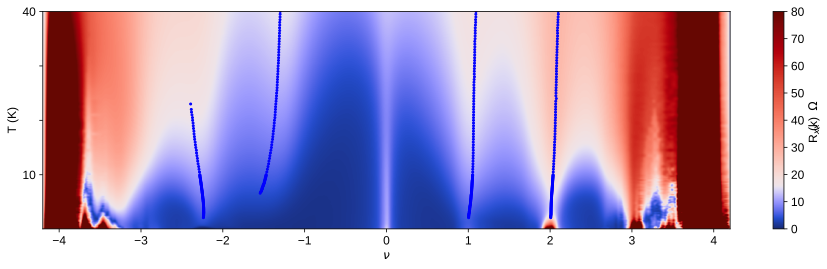

In [131]:
x = np.linspace(-4.5, 4.5, 1000)
y = np.linspace(0.025, 40, 600)
R0708Tint = R0708Tfunc(x, y).T

plt.figure(figsize=(15.4, 4))
plt.pcolormesh(x, y, gaussian_filter(R0708Tint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=16, vmin=0, vmax=80), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)


quadpadq = 12
peaknu_W3_mquarter_Tsweep = np.zeros(len(temps))
peaknu_W3_mquarter_Tsweep_2 = np.zeros(len(temps))
peakT_W3_mquarter= np.zeros(len(temps))
for i in range(57, len(temps)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 180:300], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_Tsweep[i] = np.nan   
        peaknu_W3_mquarter_Tsweep_2[i] = np.nan
        peakT_W3_mquarter[i] = np.nan
    else:
        pind = 180 + peaks[0]
        peaknu_W3_mquarter_Tsweep[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mquarter_Tsweep[i], temps[i], ".", color = 'green', markersize = 4)
        peakT_W3_mquarter[i] = temps[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_Tsweep_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)  

quadpad = 7
peaknu_W3_mhalf_Tsweep = np.zeros(len(temps))
peaknu_W3_mhalf_Tsweep_2 = np.zeros(len(temps))
peakT_W3_mhalf= np.zeros(len(temps))
for i in range(30, len(temps)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 130:200], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_Tsweep[i] = np.nan   
        peaknu_W3_mhalf_Tsweep_2[i] = np.nan
        peakT_W3_mhalf[i] = np.nan
    else:
        pind = 130 + peaks[0]
        peaknu_W3_mhalf_Tsweep[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mhalf_Tsweep[i], temps[i], ".", color = 'green', markersize = 4)
        peakT_W3_mhalf[i] = temps[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_Tsweep_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)  


quadpadq = 12
peaknu_W3_quarter_Tsweep = np.zeros(len(temps))
peaknu_W3_quarter_Tsweep_2 = np.zeros(len(temps))
peakT_W3_quarter= np.zeros(len(temps))
for i in range(30, len(temps)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 380:450], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_Tsweep[i] = np.nan   
        peaknu_W3_quarter_Tsweep_2[i] = np.nan
        peakT_W3_quarter[i] = np.nan
    else:
        pind = 380 + peaks[0]
        peaknu_W3_quarter_Tsweep[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_quarter_Tsweep[i], temps[i], ".", color = 'green', markersize = 4)
        peakT_W3_quarter[i] = temps[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_Tsweep_2[i] = nu0
        plt.plot(peaknu_W3_quarter_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)  

quadpad = 7
peaknu_W3_half_Tsweep = np.zeros(len(temps))
peaknu_W3_half_Tsweep_2 = np.zeros(len(temps))
peakT_W3_half= np.zeros(len(temps))
for i in range(30, len(temps)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 450:530], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_Tsweep[i] = np.nan   
        peaknu_W3_half_Tsweep_2[i] = np.nan
        peakT_W3_half[i] = np.nan
    else:
        pind = 450 + peaks[0]
        peaknu_W3_half_Tsweep[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_half_Tsweep[i], temps[i], ".", color = 'green', markersize = 4)
        peakT_W3_half[i] = temps[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_Tsweep_2[i] = nu0
        plt.plot(peaknu_W3_half_Tsweep_2[i], temps[i], '.', color='blue', markersize = 4)  




plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')
plt.xlim(-4.2,4.2)
plt.ylim(0.05, 20)
plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
# plt.savefig(figfile + 'W3_1p10_to40K.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

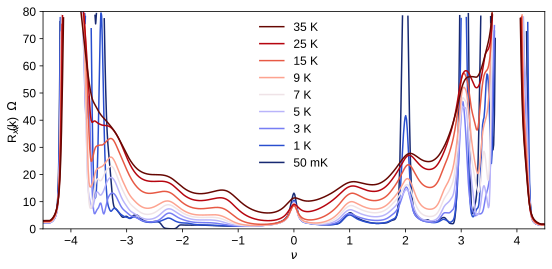

In [106]:
plt.figure(figsize=(9, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

xmin, xmax = -4.5, 4.5
ymin, ymax = 0, 80

#interpolate so that the lines work well
xpts = np.linspace(-4.5, 4.5, 2501)

R0708_pts = np.zeros((R0708.shape[0], len(xpts)))
for i in range(R0708.shape[0]):
    R0708_pts[i, :] = np.interp(xpts, nugate0708, gaussian_filter(R0708[i, :], 2)/1000)

lines = []
lines.append(plt.plot(xpts, np.ma.masked_outside(R0708_pts[0, :], ymin, ymax), label='{} K'.format(temps[0]), color = cs[0]))

for i in range(1,9):
    indx=i*20 - 1
    lines.append(plt.plot(xpts, np.ma.masked_outside(R0708_pts[indx, :], ymin, ymax), label='{} K'.format(temps[indx]), color = cs[i]))

lines = [l[0] for l in lines]
plt.legend(lines[::-1], ['50 mK', '1 K', '3 K', '5 K', '7 K', '9 K', '15 K', '25 K', '35 K'][::-1], frameon=False)
# plt.legend(frameon=False)
plt.xlim(xmin ,xmax)
plt.ylim(0,80)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

# plt.savefig(figfile + 'W3_Tlineplots.svg', dpi=300, bbox_inches='tight')

## deviceW3, 1.1$^\circ$ 5T

In [107]:
dtemp_5T_1 = qc.load_data('data/2020-10-11/#002_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweepto1K_5T_20-35-13')
dtemp_5T_2 = qc.load_data('data/2020-10-12/#001_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep1p05to1p4K_5T_00-59-56')
dtemp_5T_3 = qc.load_data('data/2020-10-12/#002_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep1p45to2K_5T_02-46-19')
dtemp_5T_4 = qc.load_data('data/2020-10-12/#003_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep2p1to10K_5T_09-50-31')
dtemp_5T_5 = qc.load_data('data/2020-10-13/#001_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep10p5to25K_5T_03-28-35')

In [108]:
temps_5T = np.concatenate((dtemp_5T_1.triton_pid_setpoint_set, dtemp_5T_2.triton_pid_setpoint_set[:], dtemp_5T_3.triton_pid_setpoint_set, dtemp_5T_4.triton_pid_setpoint_set[:], dtemp_5T_5.triton_pid_setpoint_set))
tgate_5T = dtemp_5T_1.srframe_volt_p1_set[0,:]
R0708_5T = np.vstack((npd.Rxxfromdata(dtemp_5T_1, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5T_2, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5T_3, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5T_4, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_5T_5, 2e-9, 'lockin865')))

In [109]:
Vgatefull0708 = 7.48
V00708 = 0.2

In [110]:
nugate0708_5T = np.interp(tgate_5T, [V00708 - Vgatefull0708*4/4, V00708 + Vgatefull0708*4/4], [-4, 4])
R0708Tfunc = RectBivariateSpline(nugate0708_5T, temps_5T, R0708_5T.T, kx=1, ky=1)

(0.05, 25.0)

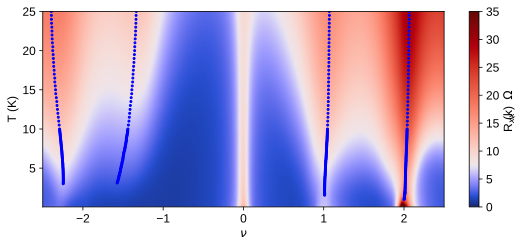

In [111]:
x = np.linspace(-4, 4, 1000)
y = np.linspace(0.025, 25, 600)
R0708T_5T_int = R0708Tfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R0708T_5T_int, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=7.5, vmin=0, vmax=35), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)


quadpadq = 12
peaknu_W3_mquarter_Tsweep_5T = np.zeros(len(temps_5T))
peaknu_W3_mquarter_Tsweep_5T_2 = np.zeros(len(temps_5T))
peakT_W3_mquarter_5T= np.zeros(len(temps_5T))
for i in range(50, len(temps_5T)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_5T[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_Tsweep_5T[i] = np.nan   
        peaknu_W3_mquarter_Tsweep_5T_2[i] = np.nan
        peakT_W3_mquarter_5T[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_Tsweep_5T[i] = nugate0708_5T[pind]
        #plt.plot(peaknu_W3_mquarter_Tsweep_5T[i], temps_5T[i], ".", color = 'green', markersize = 4)
        peakT_W3_mquarter_5T[i] = temps_5T[i]
        theta = np.polyfit(nugate0708_5T[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708_5T[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_Tsweep_5T_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_Tsweep_5T_2[i], temps_5T[i], '.', color='blue', markersize = 4)  

quadpad = 7
peaknu_W3_mhalf_Tsweep_5T = np.zeros(len(temps_5T))
peaknu_W3_mhalf_Tsweep_5T_2 = np.zeros(len(temps_5T))
peakT_W3_mhalf_5T= np.zeros(len(temps_5T))
for i in range(49, len(temps_5T)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_5T[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_Tsweep_5T[i] = np.nan   
        peaknu_W3_mhalf_Tsweep_5T_2[i] = np.nan
        peakT_W3_mhalf_5T[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_Tsweep_5T[i] = nugate0708_5T[pind]
        #plt.plot(peaknu_W3_mhalf_Tsweep_5T[i], temps_5T[i], ".", color = 'green', markersize = 4)
        peakT_W3_mhalf_5T[i] = temps_5T[i]
        theta = np.polyfit(nugate0708_5T[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708_5T[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_Tsweep_5T_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_Tsweep_5T_2[i], temps_5T[i], '.', color='blue', markersize = 4)  


quadpadq = 12
peaknu_W3_quarter_Tsweep_5T = np.zeros(len(temps_5T))
peaknu_W3_quarter_Tsweep_5T_2 = np.zeros(len(temps_5T))
peakT_W3_quarter_5T= np.zeros(len(temps_5T))
for i in range(30, len(temps_5T)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_5T[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_Tsweep_5T[i] = np.nan   
        peaknu_W3_quarter_Tsweep_5T_2[i] = np.nan
        peakT_W3_quarter_5T[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_Tsweep_5T[i] = nugate0708_5T[pind]
        #plt.plot(peaknu_W3_quarter_Tsweep_5T[i], temps_5T[i], ".", color = 'green', markersize = 4)
        peakT_W3_quarter_5T[i] = temps_5T[i]
        theta = np.polyfit(nugate0708_5T[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708_5T[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_Tsweep_5T_2[i] = nu0
        plt.plot(peaknu_W3_quarter_Tsweep_5T_2[i], temps_5T[i], '.', color='blue', markersize = 4)  

quadpad = 7
peaknu_W3_half_Tsweep_5T = np.zeros(len(temps_5T))
peaknu_W3_half_Tsweep_5T_2 = np.zeros(len(temps_5T))
peakT_W3_half_5T= np.zeros(len(temps_5T))
for i in range(19, len(temps_5T)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_5T[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_Tsweep_5T[i] = np.nan   
        peaknu_W3_half_Tsweep_5T_2[i] = np.nan
        peakT_W3_half_5T[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_Tsweep_5T[i] = nugate0708_5T[pind]
        #plt.plot(peaknu_W3_half_Tsweep_5T[i], temps_5T[i], ".", color = 'green', markersize = 4)
        peakT_W3_half_5T[i] = temps_5T[i]
        theta = np.polyfit(nugate0708_5T[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708_5T[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_Tsweep_5T_2[i] = nu0
        plt.plot(peaknu_W3_half_Tsweep_5T_2[i], temps_5T[i], '.', color='blue', markersize = 4)  




plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')
plt.xlim(-2.5,2.5)
plt.ylim(0.05, 25)
#plt.yticks([5 ,10, 15, 20, 25], ['',10,  '', '', 25])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

## deviceW3, 1.1$^\circ$ 8T

In [132]:
dtemp_8T_1 = qc.load_data('data/2020-10-09/#002_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweepto1K_8T_20-59-16')
dtemp_8T_2 = qc.load_data('data/2020-10-10/#001_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep1p05to1p4K_8T_01-23-35')
dtemp_8T_3 = qc.load_data('data/2020-10-10/#002_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep1p45to2K_8T_03-09-50')
dtemp_8T_4 = qc.load_data('data/2020-10-10/#003_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep2p1to10K_8T_10-37-16')
dtemp_8T_5 = qc.load_data('data/2020-10-11/#001_W3_865_7-8_830_8-9_2nA_0Bfield_gateTsweep10p5to25K_8T_04-12-48')

In [133]:
temps_8T = np.concatenate((dtemp_8T_1.triton_pid_setpoint_set, dtemp_8T_2.triton_pid_setpoint_set[:], dtemp_8T_3.triton_pid_setpoint_set, dtemp_8T_4.triton_pid_setpoint_set[:], dtemp_8T_5.triton_pid_setpoint_set))
tgate_8T = dtemp_8T_1.srframe_volt_p1_set[0,:]
R0708_8T = np.vstack((npd.Rxxfromdata(dtemp_8T_1, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_8T_2, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_8T_3, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_8T_4, 2e-9, 'lockin865'), npd.Rxxfromdata(dtemp_8T_5, 2e-9, 'lockin865')))

In [134]:
Vgatefull0708 = 7.48
V00708 = 0.2

In [135]:
nugate0708_8T = np.interp(tgate_8T, [V00708 - Vgatefull0708*4/4, V00708 + Vgatefull0708*4/4], [-4, 4])
R0708Tfunc = RectBivariateSpline(nugate0708_8T, temps_8T, R0708_8T.T, kx=1, ky=1)

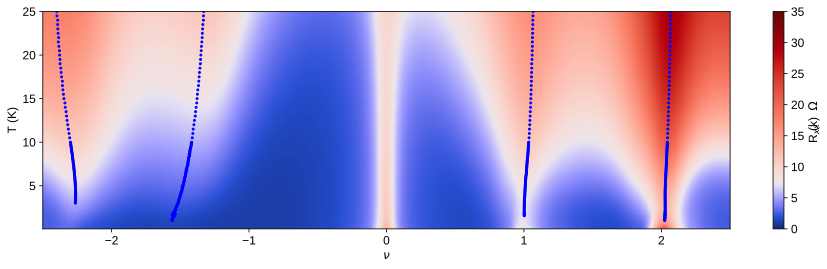

In [137]:
x = np.linspace(-4, 4, 1000)
y = np.linspace(0.025, 25, 600)
R0708T_8T_int = R0708Tfunc(x, y).T

plt.figure(figsize=(15.4, 4))
plt.pcolormesh(x, y, gaussian_filter(R0708T_8T_int, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=7.5, vmin=0, vmax=35), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)


quadpadq = 12
peaknu_W3_mquarter_Tsweep_8T = np.zeros(len(temps_8T))
peaknu_W3_mquarter_Tsweep_8T_2 = np.zeros(len(temps_8T))
peakT_W3_mquarter_8T= np.zeros(len(temps_8T))
for i in range(19, len(temps_8T)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_8T[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_Tsweep_8T[i] = np.nan   
        peaknu_W3_mquarter_Tsweep_8T_2[i] = np.nan
        peakT_W3_mquarter_8T[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_Tsweep_8T[i] = nugate0708_8T[pind]
        #plt.plot(peaknu_W3_mquarter_Tsweep_8T[i], temps_8T[i], ".", color = 'green', markersize = 4)
        peakT_W3_mquarter_8T[i] = temps_8T[i]
        theta = np.polyfit(nugate0708_8T[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708_8T[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_Tsweep_8T_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_Tsweep_8T_2[i], temps_8T[i], '.', color='blue', markersize = 4)  

quadpad = 7
peaknu_W3_mhalf_Tsweep_8T = np.zeros(len(temps_8T))
peaknu_W3_mhalf_Tsweep_8T_2 = np.zeros(len(temps_8T))
peakT_W3_mhalf_8T= np.zeros(len(temps_8T))
for i in range(49, len(temps_8T)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_8T[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_Tsweep_8T[i] = np.nan   
        peaknu_W3_mhalf_Tsweep_8T_2[i] = np.nan
        peakT_W3_mhalf_8T[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_Tsweep_8T[i] = nugate0708_8T[pind]
        #plt.plot(peaknu_W3_mhalf_Tsweep_8T[i], temps_8T[i], ".", color = 'green', markersize = 4)
        peakT_W3_mhalf_8T[i] = temps_8T[i]
        theta = np.polyfit(nugate0708_8T[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708_8T[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_Tsweep_8T_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_Tsweep_8T_2[i], temps_8T[i], '.', color='blue', markersize = 4)  


quadpadq = 12
peaknu_W3_quarter_Tsweep_8T = np.zeros(len(temps_8T))
peaknu_W3_quarter_Tsweep_8T_2 = np.zeros(len(temps_8T))
peakT_W3_quarter_8T= np.zeros(len(temps_8T))
for i in range(30, len(temps_8T)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_8T[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_Tsweep_8T[i] = np.nan   
        peaknu_W3_quarter_Tsweep_8T_2[i] = np.nan
        peakT_W3_quarter_8T[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_Tsweep_8T[i] = nugate0708_8T[pind]
        #plt.plot(peaknu_W3_quarter_Tsweep_8T[i], temps_8T[i], ".", color = 'green', markersize = 4)
        peakT_W3_quarter_8T[i] = temps_8T[i]
        theta = np.polyfit(nugate0708_8T[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708_8T[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_Tsweep_8T_2[i] = nu0
        plt.plot(peaknu_W3_quarter_Tsweep_8T_2[i], temps_8T[i], '.', color='blue', markersize = 4)  

quadpad = 7
peaknu_W3_half_Tsweep_8T = np.zeros(len(temps_8T))
peaknu_W3_half_Tsweep_8T_2 = np.zeros(len(temps_8T))
peakT_W3_half_8T= np.zeros(len(temps_8T))
for i in range(19, len(temps_8T)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_8T[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_Tsweep_8T[i] = np.nan   
        peaknu_W3_half_Tsweep_8T_2[i] = np.nan
        peakT_W3_half_8T[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_Tsweep_8T[i] = nugate0708_8T[pind]
        #plt.plot(peaknu_W3_half_Tsweep_8T[i], temps_8T[i], ".", color = 'green', markersize = 4)
        peakT_W3_half_8T[i] = temps_8T[i]
        theta = np.polyfit(nugate0708_8T[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708_8T[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_Tsweep_8T_2[i] = nu0
        plt.plot(peaknu_W3_half_Tsweep_8T_2[i], temps_8T[i], '.', color='blue', markersize = 4)  




plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')
plt.xlim(-2.5,2.5)
plt.ylim(0.05, 25)
#plt.yticks([5 ,10, 15, 20, 25], ['',10,  '', '', 25])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
# plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

In [ ]:
TwoSlopeNorm(vcenter=16, vmin=0, vmax=80)

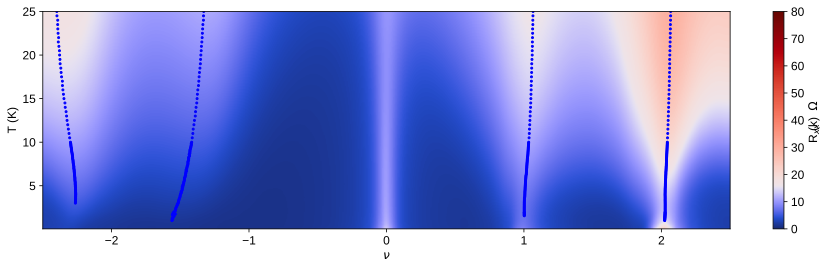

In [139]:
x = np.linspace(-4, 4, 1000)
y = np.linspace(0.025, 25, 600)
R0708T_8T_int = R0708Tfunc(x, y).T

plt.figure(figsize=(15.4, 4))
plt.pcolormesh(x, y, gaussian_filter(R0708T_8T_int, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=16, vmin=0, vmax=80), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)


quadpadq = 12
peaknu_W3_mquarter_Tsweep_8T = np.zeros(len(temps_8T))
peaknu_W3_mquarter_Tsweep_8T_2 = np.zeros(len(temps_8T))
peakT_W3_mquarter_8T= np.zeros(len(temps_8T))
for i in range(19, len(temps_8T)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_8T[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_Tsweep_8T[i] = np.nan   
        peaknu_W3_mquarter_Tsweep_8T_2[i] = np.nan
        peakT_W3_mquarter_8T[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_Tsweep_8T[i] = nugate0708_8T[pind]
        #plt.plot(peaknu_W3_mquarter_Tsweep_8T[i], temps_8T[i], ".", color = 'green', markersize = 4)
        peakT_W3_mquarter_8T[i] = temps_8T[i]
        theta = np.polyfit(nugate0708_8T[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708_8T[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_Tsweep_8T_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_Tsweep_8T_2[i], temps_8T[i], '.', color='blue', markersize = 4)  

quadpad = 7
peaknu_W3_mhalf_Tsweep_8T = np.zeros(len(temps_8T))
peaknu_W3_mhalf_Tsweep_8T_2 = np.zeros(len(temps_8T))
peakT_W3_mhalf_8T= np.zeros(len(temps_8T))
for i in range(49, len(temps_8T)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_8T[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_Tsweep_8T[i] = np.nan   
        peaknu_W3_mhalf_Tsweep_8T_2[i] = np.nan
        peakT_W3_mhalf_8T[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_Tsweep_8T[i] = nugate0708_8T[pind]
        #plt.plot(peaknu_W3_mhalf_Tsweep_8T[i], temps_8T[i], ".", color = 'green', markersize = 4)
        peakT_W3_mhalf_8T[i] = temps_8T[i]
        theta = np.polyfit(nugate0708_8T[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708_8T[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_Tsweep_8T_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_Tsweep_8T_2[i], temps_8T[i], '.', color='blue', markersize = 4)  


quadpadq = 12
peaknu_W3_quarter_Tsweep_8T = np.zeros(len(temps_8T))
peaknu_W3_quarter_Tsweep_8T_2 = np.zeros(len(temps_8T))
peakT_W3_quarter_8T= np.zeros(len(temps_8T))
for i in range(30, len(temps_8T)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_8T[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_Tsweep_8T[i] = np.nan   
        peaknu_W3_quarter_Tsweep_8T_2[i] = np.nan
        peakT_W3_quarter_8T[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_Tsweep_8T[i] = nugate0708_8T[pind]
        #plt.plot(peaknu_W3_quarter_Tsweep_8T[i], temps_8T[i], ".", color = 'green', markersize = 4)
        peakT_W3_quarter_8T[i] = temps_8T[i]
        theta = np.polyfit(nugate0708_8T[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708_8T[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_Tsweep_8T_2[i] = nu0
        plt.plot(peaknu_W3_quarter_Tsweep_8T_2[i], temps_8T[i], '.', color='blue', markersize = 4)  

quadpad = 7
peaknu_W3_half_Tsweep_8T = np.zeros(len(temps_8T))
peaknu_W3_half_Tsweep_8T_2 = np.zeros(len(temps_8T))
peakT_W3_half_8T= np.zeros(len(temps_8T))
for i in range(19, len(temps_8T)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708_8T[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_Tsweep_8T[i] = np.nan   
        peaknu_W3_half_Tsweep_8T_2[i] = np.nan
        peakT_W3_half_8T[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_Tsweep_8T[i] = nugate0708_8T[pind]
        #plt.plot(peaknu_W3_half_Tsweep_8T[i], temps_8T[i], ".", color = 'green', markersize = 4)
        peakT_W3_half_8T[i] = temps_8T[i]
        theta = np.polyfit(nugate0708_8T[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708_8T[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_Tsweep_8T_2[i] = nu0
        plt.plot(peaknu_W3_half_Tsweep_8T_2[i], temps_8T[i], '.', color='blue', markersize = 4)  




plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')
plt.xlim(-2.5,2.5)
plt.ylim(0.05, 25)
#plt.yticks([5 ,10, 15, 20, 25], ['',10,  '', '', 25])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

# in plane field dependence

## deviceW3, 1.1$^\circ$

### 1K

In [46]:
d_inplane_W3_1K_1 = qc.load_data('data/2020-10-03/#002_W3_865_7-8_830_8-9_2nA_0to6T_fieldgate_1K_12-17-41')
d_inplane_W3_1K_2 = qc.load_data('data/2020-10-03/#003_W3_865_7-8_830_8-9_2nA_6p1to8T_fieldgate_1K_23-47-28')

In [47]:
Bfield = np.concatenate((d_inplane_W3_1K_1.triton_field_set_stable_set, d_inplane_W3_1K_2.triton_field_set_stable_set))
Bgate = d_inplane_W3_1K_1.srframe_volt_p1_set[0, :]
R0708 = np.vstack((npd.Rxxfromdata(d_inplane_W3_1K_1, 2e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_W3_1K_2, 2e-9, 'lockin865')))

In [48]:
Vgatefull0708 = 7.48
V00708 = 0.2

In [49]:
nugate0708 = np.interp(Bgate, [V00708 - Vgatefull0708*3/4, V00708 + Vgatefull0708*3/4], [-3, 3])

In [50]:
R0708Bfunc = RectBivariateSpline(nugate0708, Bfield, R0708.T, kx=1, ky=1)

In [51]:
nugate0708[180]

-0.8556149732620324

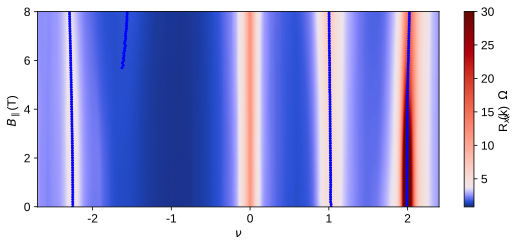

In [52]:
x = np.linspace(-3, 3, 1000)
y = np.linspace(0, 8, 600)
R0708Bint = R0708Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R0708Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=3.7, vmin=0.8, vmax=30), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([-2, -1, 0, 1, 2], [-2, -1, 0 ,1, 2])
plt.xlim(-2.7,2.4)

quadpadq = 12
peaknu_W3_mquarter_B_1K = np.zeros(len(Bfield))
peaknu_W3_mquarter_B_1K_2 = np.zeros(len(Bfield))
peakB_W3_mquarter_B_1K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_B_1K[i] = np.nan   
        peaknu_W3_mquarter_B_1K_2[i] = np.nan
        peakB_W3_mquarter_B_1K[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_B_1K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mquarter_B_1K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mquarter_B_1K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_B_1K_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_B_1K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_mhalf_B_1K = np.zeros(len(Bfield))
peaknu_W3_mhalf_B_1K_2 = np.zeros(len(Bfield))
peakB_W3_mhalf_B_1K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_B_1K[i] = np.nan   
        peaknu_W3_mhalf_B_1K_2[i] = np.nan
        peakB_W3_mhalf_B_1K[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_B_1K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mhalf_B_1K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mhalf_B_1K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_B_1K_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_B_1K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpadq = 12
peaknu_W3_quarter_B_1K = np.zeros(len(Bfield))
peaknu_W3_quarter_B_1K_2 = np.zeros(len(Bfield))
peakB_W3_quarter_B_1K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_B_1K[i] = np.nan   
        peaknu_W3_quarter_B_1K_2[i] = np.nan
        peakB_W3_quarter_B_1K[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_B_1K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_quarter_B_1K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_quarter_B_1K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_B_1K_2[i] = nu0
        plt.plot(peaknu_W3_quarter_B_1K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_half_B_1K = np.zeros(len(Bfield))
peaknu_W3_half_B_1K_2 = np.zeros(len(Bfield))
peakB_W3_half_B_1K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_B_1K[i] = np.nan   
        peaknu_W3_half_B_1K_2[i] = np.nan
        peakB_W3_half_B_1K[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_B_1K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_half_B_1K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_half_B_1K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_B_1K_2[i] = nu0
        plt.plot(peaknu_W3_half_B_1K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

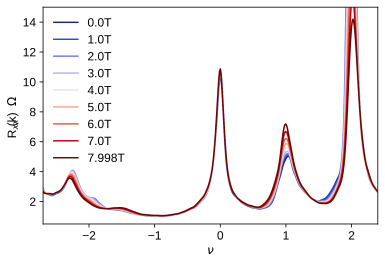

In [53]:
plt.figure(figsize=(6, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate0708[:], gaussian_filter(R0708[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(-2.7,2.4)
plt.ylim(0.5,15)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 3K

In [54]:
d_inplane_W3_3K_1 = qc.load_data('data/2020-10-04/#001_W3_865_7-8_830_8-9_2nA_8to6p1T_fieldgate_3K_10-18-24')
d_inplane_W3_3K_2 = qc.load_data('data/2020-10-04/#002_W3_865_7-8_830_8-9_2nA_6to0T_fieldgate_3K_19-00-08')

In [55]:
Bfield = np.concatenate((d_inplane_W3_3K_1.triton_field_set_stable_set, d_inplane_W3_3K_2.triton_field_set_stable_set))
Bgate = d_inplane_W3_3K_1.srframe_volt_p1_set[0, :]
R0708 = np.vstack((npd.Rxxfromdata(d_inplane_W3_3K_1, 2e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_W3_3K_2, 2e-9, 'lockin865')))

In [56]:
Bfield = Bfield[::-1]
R0708 = np.flip(R0708, axis=0)

In [57]:
Vgatefull0708 = 7.48
V00708 = 0.2
nugate0708 = np.interp(Bgate, [V00708 - Vgatefull0708*3/4, V00708 + Vgatefull0708*3/4], [-3, 3])
R0708Bfunc = RectBivariateSpline(nugate0708, Bfield, R0708.T, kx=1, ky=1)

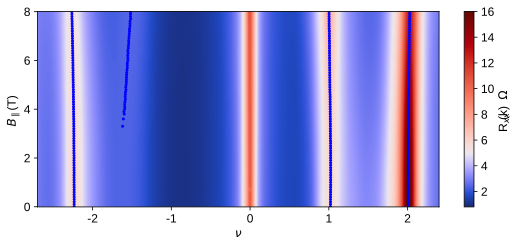

In [58]:
x = np.linspace(-3, 3, 1000)
y = np.linspace(0, 8, 600)
R0708Bint = R0708Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R0708Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=5, vmin=0.8, vmax=16), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([-2, -1, 0, 1, 2], [-2, -1, 0 ,1, 2])
plt.xlim(-2.7,2.4)

quadpadq = 12
peaknu_W3_mquarter_B_3K = np.zeros(len(Bfield))
peaknu_W3_mquarter_B_3K_2 = np.zeros(len(Bfield))
peakB_W3_mquarter_B_3K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_B_3K[i] = np.nan   
        peaknu_W3_mquarter_B_3K_2[i] = np.nan
        peakB_W3_mquarter_B_3K[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_B_3K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mquarter_B_3K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mquarter_B_3K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_B_3K_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_B_3K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_mhalf_B_3K = np.zeros(len(Bfield))
peaknu_W3_mhalf_B_3K_2 = np.zeros(len(Bfield))
peakB_W3_mhalf_B_3K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_B_3K[i] = np.nan   
        peaknu_W3_mhalf_B_3K_2[i] = np.nan
        peakB_W3_mhalf_B_3K[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_B_3K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mhalf_B_3K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mhalf_B_3K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_B_3K_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_B_3K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpadq = 12
peaknu_W3_quarter_B_3K = np.zeros(len(Bfield))
peaknu_W3_quarter_B_3K_2 = np.zeros(len(Bfield))
peakB_W3_quarter_B_3K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_B_3K[i] = np.nan   
        peaknu_W3_quarter_B_3K_2[i] = np.nan
        peakB_W3_quarter_B_3K[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_B_3K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_quarter_B_3K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_quarter_B_3K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_B_3K_2[i] = nu0
        plt.plot(peaknu_W3_quarter_B_3K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_half_B_3K = np.zeros(len(Bfield))
peaknu_W3_half_B_3K_2 = np.zeros(len(Bfield))
peakB_W3_half_B_3K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_B_3K[i] = np.nan   
        peaknu_W3_half_B_3K_2[i] = np.nan
        peakB_W3_half_B_3K[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_B_3K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_half_B_3K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_half_B_3K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_B_3K_2[i] = nu0
        plt.plot(peaknu_W3_half_B_3K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

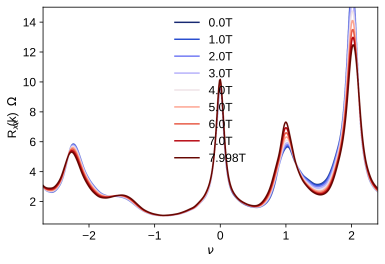

In [59]:
plt.figure(figsize=(6, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate0708[:], gaussian_filter(R0708[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(-2.7,2.4)
plt.ylim(0.5,15)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 5K

In [60]:
d_inplane_W3_5K_1 = qc.load_data('data/2020-10-05/#001_W3_865_7-8_830_8-9_2nA_0to6T_fieldgate_5K_06-54-04')
d_inplane_W3_5K_2 = qc.load_data('data/2020-10-05/#002_W3_865_7-8_830_8-9_2nA_6p1to8T_fieldgate_5K_18-20-17')

In [61]:
Bfield = np.concatenate((d_inplane_W3_5K_1.triton_field_set_stable_set, d_inplane_W3_5K_2.triton_field_set_stable_set))
Bgate = d_inplane_W3_5K_1.srframe_volt_p1_set[0, :]
R0708 = np.vstack((npd.Rxxfromdata(d_inplane_W3_5K_1, 2e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_W3_5K_2, 2e-9, 'lockin865')))

In [62]:
Vgatefull0708 = 7.48
V00708 = 0.2
nugate0708 = np.interp(Bgate, [V00708 - Vgatefull0708*3/4, V00708 + Vgatefull0708*3/4], [-3, 3])
R0708Bfunc = RectBivariateSpline(nugate0708, Bfield, R0708.T, kx=1, ky=1)

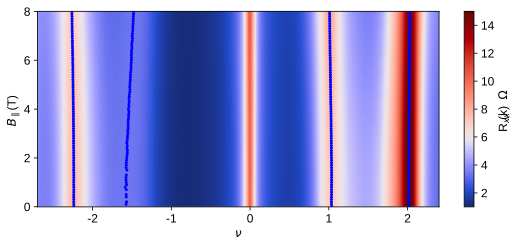

In [63]:
x = np.linspace(-3, 3, 1000)
y = np.linspace(0, 8, 600)
R0708Bint = R0708Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R0708Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=6, vmin=1, vmax=15), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([-2, -1, 0, 1, 2], [-2, -1, 0 ,1, 2])
plt.xlim(-2.7,2.4)

quadpadq = 12
peaknu_W3_mquarter_B_5K = np.zeros(len(Bfield))
peaknu_W3_mquarter_B_5K_2 = np.zeros(len(Bfield))
peakB_W3_mquarter_B_5K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_B_5K[i] = np.nan   
        peaknu_W3_mquarter_B_5K_2[i] = np.nan
        peakB_W3_mquarter_B_5K[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_B_5K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mquarter_B_5K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mquarter_B_5K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_B_5K_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_B_5K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_mhalf_B_5K = np.zeros(len(Bfield))
peaknu_W3_mhalf_B_5K_2 = np.zeros(len(Bfield))
peakB_W3_mhalf_B_5K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_B_5K[i] = np.nan   
        peaknu_W3_mhalf_B_5K_2[i] = np.nan
        peakB_W3_mhalf_B_5K[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_B_5K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mhalf_B_5K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mhalf_B_5K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_B_5K_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_B_5K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpadq = 12
peaknu_W3_quarter_B_5K = np.zeros(len(Bfield))
peaknu_W3_quarter_B_5K_2 = np.zeros(len(Bfield))
peakB_W3_quarter_B_5K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_B_5K[i] = np.nan   
        peaknu_W3_quarter_B_5K_2[i] = np.nan
        peakB_W3_quarter_B_5K[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_B_5K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_quarter_B_5K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_quarter_B_5K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_B_5K_2[i] = nu0
        plt.plot(peaknu_W3_quarter_B_5K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_half_B_5K = np.zeros(len(Bfield))
peaknu_W3_half_B_5K_2 = np.zeros(len(Bfield))
peakB_W3_half_B_5K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_B_5K[i] = np.nan   
        peaknu_W3_half_B_5K_2[i] = np.nan
        peakB_W3_half_B_5K[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_B_5K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_half_B_5K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_half_B_5K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_B_5K_2[i] = nu0
        plt.plot(peaknu_W3_half_B_5K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

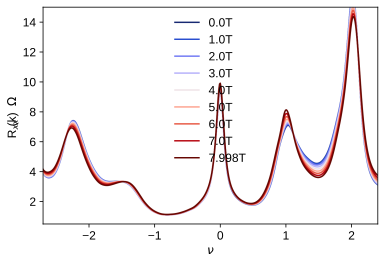

In [64]:
plt.figure(figsize=(6, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate0708[:], gaussian_filter(R0708[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(-2.7,2.4)
plt.ylim(0.5,15)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 7.5K

In [65]:
d_inplane_W3_7p5K_1 = qc.load_data('data/2020-10-06/#001_W3_865_7-8_830_8-9_2nA_8to6p1T_fieldgate_7p5K_03-14-41')
d_inplane_W3_7p5K_2 = qc.load_data('data/2020-10-06/#002_W3_865_7-8_830_8-9_2nA_6to0T_fieldgate_7p5K_11-56-25')

In [66]:
Bfield = np.concatenate((d_inplane_W3_7p5K_1.triton_field_set_stable_set, d_inplane_W3_7p5K_2.triton_field_set_stable_set))
Bgate = d_inplane_W3_7p5K_1.srframe_volt_p1_set[0, :]
R0708 = np.vstack((npd.Rxxfromdata(d_inplane_W3_7p5K_1, 2e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_W3_7p5K_2, 2e-9, 'lockin865')))

In [67]:
Bfield = Bfield[::-1]
R0708 = np.flip(R0708, axis=0)

In [68]:
Vgatefull0708 = 7.48
V00708 = 0.2
nugate0708 = np.interp(Bgate, [V00708 - Vgatefull0708*3/4, V00708 + Vgatefull0708*3/4], [-3, 3])
R0708Bfunc = RectBivariateSpline(nugate0708, Bfield, R0708.T, kx=1, ky=1)

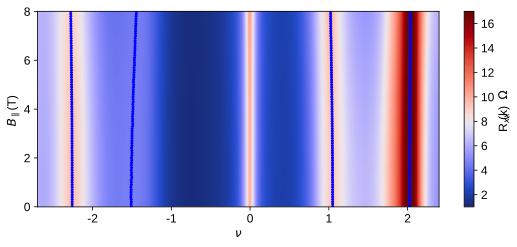

In [69]:
x = np.linspace(-3, 3, 1000)
y = np.linspace(0, 8, 600)
R0708Bint = R0708Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R0708Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=8, vmin=1, vmax=17), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([-2, -1, 0, 1, 2], [-2, -1, 0 ,1, 2])
plt.xlim(-2.7,2.4)

quadpadq = 12
peaknu_W3_mquarter_B_7p5K = np.zeros(len(Bfield))
peaknu_W3_mquarter_B_7p5K_2 = np.zeros(len(Bfield))
peakB_W3_mquarter_B_7p5K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_B_7p5K[i] = np.nan   
        peaknu_W3_mquarter_B_7p5K_2[i] = np.nan
        peakB_W3_mquarter_B_7p5K[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_B_7p5K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mquarter_B_7p5K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mquarter_B_7p5K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_B_7p5K_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_B_7p5K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_mhalf_B_7p5K = np.zeros(len(Bfield))
peaknu_W3_mhalf_B_7p5K_2 = np.zeros(len(Bfield))
peakB_W3_mhalf_B_7p5K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_B_7p5K[i] = np.nan   
        peaknu_W3_mhalf_B_7p5K_2[i] = np.nan
        peakB_W3_mhalf_B_7p5K[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_B_7p5K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mhalf_B_7p5K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mhalf_B_7p5K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_B_7p5K_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_B_7p5K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpadq = 12
peaknu_W3_quarter_B_7p5K = np.zeros(len(Bfield))
peaknu_W3_quarter_B_7p5K_2 = np.zeros(len(Bfield))
peakB_W3_quarter_B_7p5K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_B_7p5K[i] = np.nan   
        peaknu_W3_quarter_B_7p5K_2[i] = np.nan
        peakB_W3_quarter_B_7p5K[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_B_7p5K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_quarter_B_7p5K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_quarter_B_7p5K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_B_7p5K_2[i] = nu0
        plt.plot(peaknu_W3_quarter_B_7p5K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_half_B_7p5K = np.zeros(len(Bfield))
peaknu_W3_half_B_7p5K_2 = np.zeros(len(Bfield))
peakB_W3_half_B_7p5K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_B_7p5K[i] = np.nan   
        peaknu_W3_half_B_7p5K_2[i] = np.nan
        peakB_W3_half_B_7p5K[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_B_7p5K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_half_B_7p5K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_half_B_7p5K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_B_7p5K_2[i] = nu0
        plt.plot(peaknu_W3_half_B_7p5K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

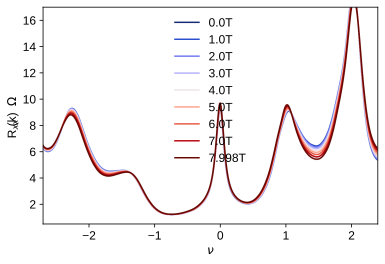

In [70]:
plt.figure(figsize=(6, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate0708[:], gaussian_filter(R0708[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(-2.7,2.4)
plt.ylim(0.5,17)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 10K

In [71]:
d_inplane_W3_10K_1 = qc.load_data('data/2020-10-06/#003_W3_865_7-8_830_8-9_2nA_0to6T_fieldgate_10K_23-54-16')
d_inplane_W3_10K_2 = qc.load_data('data/2020-10-07/#001_W3_865_7-8_830_8-9_2nA_6p1to8T_fieldgate_10K_11-32-09')

In [72]:
Bfield = np.concatenate((d_inplane_W3_10K_1.triton_field_set_stable_set, d_inplane_W3_10K_2.triton_field_set_stable_set))
Bgate = d_inplane_W3_10K_1.srframe_volt_p1_set[0, :]
R0708 = np.vstack((npd.Rxxfromdata(d_inplane_W3_10K_1, 2e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_W3_10K_2, 2e-9, 'lockin865')))

In [73]:
Vgatefull0708 = 7.48
V00708 = 0.2
nugate0708 = np.interp(Bgate, [V00708 - Vgatefull0708*3/4, V00708 + Vgatefull0708*3/4], [-3, 3])
R0708Bfunc = RectBivariateSpline(nugate0708, Bfield, R0708.T, kx=1, ky=1)

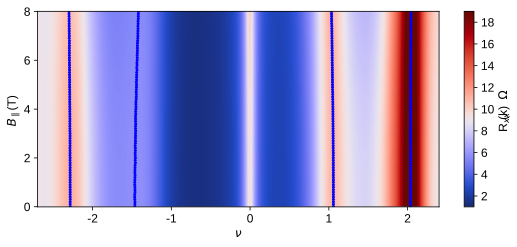

In [74]:
x = np.linspace(-3, 3, 1000)
y = np.linspace(0, 8, 600)
R0708Bint = R0708Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R0708Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=9, vmin=1, vmax=19), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([-2, -1, 0, 1, 2], [-2, -1, 0 ,1, 2])
plt.xlim(-2.7,2.4)

quadpadq = 12
peaknu_W3_mquarter_B_10K = np.zeros(len(Bfield))
peaknu_W3_mquarter_B_10K_2 = np.zeros(len(Bfield))
peakB_W3_mquarter_B_10K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_B_10K[i] = np.nan   
        peaknu_W3_mquarter_B_10K_2[i] = np.nan
        peakB_W3_mquarter_B_10K[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_B_10K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mquarter_B_10K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mquarter_B_10K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_B_10K_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_B_10K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_mhalf_B_10K = np.zeros(len(Bfield))
peaknu_W3_mhalf_B_10K_2 = np.zeros(len(Bfield))
peakB_W3_mhalf_B_10K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_B_10K[i] = np.nan   
        peaknu_W3_mhalf_B_10K_2[i] = np.nan
        peakB_W3_mhalf_B_10K[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_B_10K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mhalf_B_10K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mhalf_B_10K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_B_10K_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_B_10K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpadq = 12
peaknu_W3_quarter_B_10K = np.zeros(len(Bfield))
peaknu_W3_quarter_B_10K_2 = np.zeros(len(Bfield))
peakB_W3_quarter_B_10K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_B_10K[i] = np.nan   
        peaknu_W3_quarter_B_10K_2[i] = np.nan
        peakB_W3_quarter_B_10K[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_B_10K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_quarter_B_10K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_quarter_B_10K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_B_10K_2[i] = nu0
        plt.plot(peaknu_W3_quarter_B_10K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_half_B_10K = np.zeros(len(Bfield))
peaknu_W3_half_B_10K_2 = np.zeros(len(Bfield))
peakB_W3_half_B_10K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_B_10K[i] = np.nan   
        peaknu_W3_half_B_10K_2[i] = np.nan
        peakB_W3_half_B_10K[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_B_10K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_half_B_10K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_half_B_10K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_B_10K_2[i] = nu0
        plt.plot(peaknu_W3_half_B_10K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

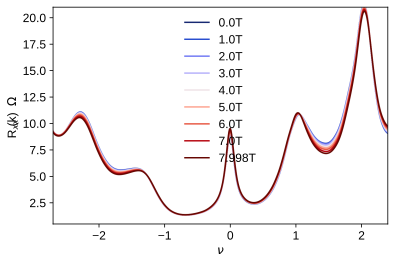

In [75]:
plt.figure(figsize=(6, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate0708[:], gaussian_filter(R0708[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(-2.7,2.4)
plt.ylim(0.5,21)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 14K

In [76]:
d_inplane_W3_14K_1 = qc.load_data('data/2020-10-07/#002_W3_865_7-8_830_8-9_2nA_8to6p1T_fieldgate_14K_20-50-53')
d_inplane_W3_14K_2 = qc.load_data('data/2020-10-08/#001_W3_865_7-8_830_8-9_2nA_6to0T_fieldgate_14K_05-33-16')

In [77]:
Bfield = np.concatenate((d_inplane_W3_14K_1.triton_field_set_stable_set, d_inplane_W3_14K_2.triton_field_set_stable_set))
Bgate = d_inplane_W3_14K_1.srframe_volt_p1_set[0, :]
R0708 = np.vstack((npd.Rxxfromdata(d_inplane_W3_14K_1, 2e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_W3_14K_2, 2e-9, 'lockin865')))

In [78]:
Bfield = Bfield[::-1]
R0708 = np.flip(R0708, axis=0)

In [79]:
Vgatefull0708 = 7.48
V00708 = 0.2
nugate0708 = np.interp(Bgate, [V00708 - Vgatefull0708*3/4, V00708 + Vgatefull0708*3/4], [-3, 3])
R0708Bfunc = RectBivariateSpline(nugate0708, Bfield, R0708.T, kx=1, ky=1)

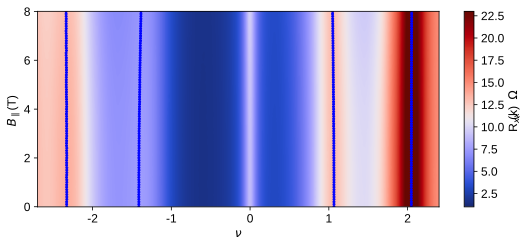

In [80]:
x = np.linspace(-3, 3, 1000)
y = np.linspace(0, 8, 600)
R0708Bint = R0708Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R0708Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=11, vmin=1, vmax=23), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([-2, -1, 0, 1, 2], [-2, -1, 0 ,1, 2])
plt.xlim(-2.7,2.4)

quadpadq = 12
peaknu_W3_mquarter_B_14K = np.zeros(len(Bfield))
peaknu_W3_mquarter_B_14K_2 = np.zeros(len(Bfield))
peakB_W3_mquarter_B_14K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_B_14K[i] = np.nan   
        peaknu_W3_mquarter_B_14K_2[i] = np.nan
        peakB_W3_mquarter_B_14K[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_B_14K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mquarter_B_14K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mquarter_B_14K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_B_14K_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_B_14K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_mhalf_B_14K = np.zeros(len(Bfield))
peaknu_W3_mhalf_B_14K_2 = np.zeros(len(Bfield))
peakB_W3_mhalf_B_14K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_B_14K[i] = np.nan   
        peaknu_W3_mhalf_B_14K_2[i] = np.nan
        peakB_W3_mhalf_B_14K[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_B_14K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mhalf_B_14K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mhalf_B_14K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_B_14K_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_B_14K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpadq = 12
peaknu_W3_quarter_B_14K = np.zeros(len(Bfield))
peaknu_W3_quarter_B_14K_2 = np.zeros(len(Bfield))
peakB_W3_quarter_B_14K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_B_14K[i] = np.nan   
        peaknu_W3_quarter_B_14K_2[i] = np.nan
        peakB_W3_quarter_B_14K[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_B_14K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_quarter_B_14K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_quarter_B_14K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_B_14K_2[i] = nu0
        plt.plot(peaknu_W3_quarter_B_14K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_half_B_14K = np.zeros(len(Bfield))
peaknu_W3_half_B_14K_2 = np.zeros(len(Bfield))
peakB_W3_half_B_14K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_B_14K[i] = np.nan   
        peaknu_W3_half_B_14K_2[i] = np.nan
        peakB_W3_half_B_14K[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_B_14K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_half_B_14K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_half_B_14K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_B_14K_2[i] = nu0
        plt.plot(peaknu_W3_half_B_14K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

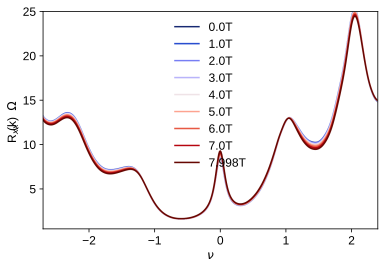

In [81]:
plt.figure(figsize=(6, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate0708[:], gaussian_filter(R0708[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(-2.7,2.4)
plt.ylim(0.5,25)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

### 18K

In [140]:
d_inplane_W3_18K_1 = qc.load_data('data/2020-10-08/#002_W3_865_7-8_830_8-9_2nA_0to6T_fieldgate_18K_17-48-55')
d_inplane_W3_18K_2 = qc.load_data('data/2020-10-09/#001_W3_865_7-8_830_8-9_2nA_6p1to8T_fieldgate_18K_05-15-55')

In [141]:
Bfield = np.concatenate((d_inplane_W3_18K_1.triton_field_set_stable_set, d_inplane_W3_18K_2.triton_field_set_stable_set))
Bgate = d_inplane_W3_18K_1.srframe_volt_p1_set[0, :]
R0708 = np.vstack((npd.Rxxfromdata(d_inplane_W3_18K_1, 2e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_W3_18K_2, 2e-9, 'lockin865')))

In [142]:
Bfield = np.concatenate((d_inplane_W3_18K_1.triton_field_set_stable_set, d_inplane_W3_18K_2.triton_field_set_stable_set))
Bgate = d_inplane_W3_18K_1.srframe_volt_p1_set[0, :]
R0708 = np.vstack((npd.Rxxfromdata(d_inplane_W3_18K_1, 2e-9, 'lockin865'), npd.Rxxfromdata(d_inplane_W3_18K_2, 2e-9, 'lockin865')))

In [143]:
Vgatefull0708 = 7.48
V00708 = 0.2
nugate0708 = np.interp(Bgate, [V00708 - Vgatefull0708*3/4, V00708 + Vgatefull0708*3/4], [-3, 3])
R0708Bfunc = RectBivariateSpline(nugate0708, Bfield, R0708.T, kx=1, ky=1)

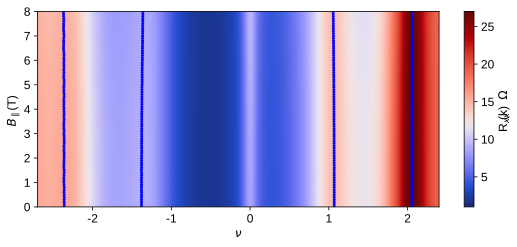

In [144]:
x = np.linspace(-3, 3, 1000)
y = np.linspace(0, 8, 600)
R0708Bint = R0708Bfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R0708Bint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=12, vmin=1, vmax=27), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xticks([-2, -1, 0, 1, 2], [-2, -1, 0 ,1, 2])
plt.xlim(-2.7,2.4)

quadpadq = 12
peaknu_W3_mquarter_B_18K = np.zeros(len(Bfield))
peaknu_W3_mquarter_B_18K_2 = np.zeros(len(Bfield))
peakB_W3_mquarter_B_18K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 80:180], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_mquarter_B_18K[i] = np.nan   
        peaknu_W3_mquarter_B_18K_2[i] = np.nan
        peakB_W3_mquarter_B_18K[i] = np.nan
    else:
        pind = 80 + peaks[0]
        peaknu_W3_mquarter_B_18K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mquarter_B_18K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mquarter_B_18K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mquarter_B_18K_2[i] = nu0
        plt.plot(peaknu_W3_mquarter_B_18K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_mhalf_B_18K = np.zeros(len(Bfield))
peaknu_W3_mhalf_B_18K_2 = np.zeros(len(Bfield))
peakB_W3_mhalf_B_18K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#minus half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 20:100], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_mhalf_B_18K[i] = np.nan   
        peaknu_W3_mhalf_B_18K_2[i] = np.nan
        peakB_W3_mhalf_B_18K[i] = np.nan
    else:
        pind = 20 + peaks[0]
        peaknu_W3_mhalf_B_18K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_mhalf_B_18K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_mhalf_B_18K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_mhalf_B_18K_2[i] = nu0
        plt.plot(peaknu_W3_mhalf_B_18K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpadq = 12
peaknu_W3_quarter_B_18K = np.zeros(len(Bfield))
peaknu_W3_quarter_B_18K_2 = np.zeros(len(Bfield))
peakB_W3_quarter_B_18K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#quarter filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 300:400], 2), prominence=0.4, width=10)
    if len(peaks) == 0:
        peaknu_W3_quarter_B_18K[i] = np.nan   
        peaknu_W3_quarter_B_18K_2[i] = np.nan
        peakB_W3_quarter_B_18K[i] = np.nan
    else:
        pind = 300 + peaks[0]
        peaknu_W3_quarter_B_18K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_quarter_B_18K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_quarter_B_18K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpadq:pind+quadpadq+1], gaussian_filter(R0708[i, pind-quadpadq:pind+quadpadq+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_quarter_B_18K_2[i] = nu0
        plt.plot(peaknu_W3_quarter_B_18K_2[i], Bfield[i], '.', color='blue', markersize = 4) 

quadpad = 7
peaknu_W3_half_B_18K = np.zeros(len(Bfield))
peaknu_W3_half_B_18K_2 = np.zeros(len(Bfield))
peakB_W3_half_B_18K= np.zeros(len(Bfield))
for i in range(len(Bfield)):#half filling tracking
    peaks, _ = find_peaks(gaussian_filter(R0708[i, 400:490], 2), prominence=0.5, width=10)
    if len(peaks) == 0:
        peaknu_W3_half_B_18K[i] = np.nan   
        peaknu_W3_half_B_18K_2[i] = np.nan
        peakB_W3_half_B_18K[i] = np.nan
    else:
        pind = 400 + peaks[0]
        peaknu_W3_half_B_18K[i] = nugate0708[pind]
        #plt.plot(peaknu_W3_half_B_18K[i], Bfield[i], ".", color = 'green', markersize = 4)
        peakB_W3_half_B_18K[i] = Bfield[i]
        theta = np.polyfit(nugate0708[pind-quadpad:pind+quadpad+1], gaussian_filter(R0708[i, pind-quadpad:pind+quadpad+1], 1.2), 2)
        nu0 = -theta[1]/(2*theta[0])
        peaknu_W3_half_B_18K_2[i] = nu0
        plt.plot(peaknu_W3_half_B_18K_2[i], Bfield[i], '.', color='blue', markersize = 4) 
        
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_lowtemp.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xx}$ (k$\\Omega$)')

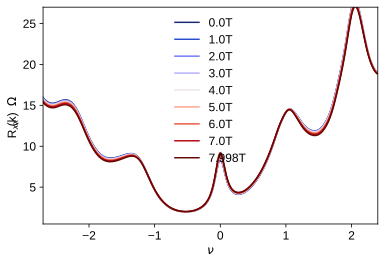

In [145]:
plt.figure(figsize=(6, 4))
N = 9
cs = plt.get_cmap(cc.cm.diverging_bwr_20_95_c54)(np.linspace(0,1,N))

for i in range(9):
    indx=i*10 
    plt.plot(nugate0708[:], gaussian_filter(R0708[indx, :], 2)/1000, label='{}T'.format(Bfield[indx]), color = cs[i], rasterized=True)
plt.legend(frameon=False)
plt.xlim(-2.7,2.4)
plt.ylim(0.5,27)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xx}$ (k$\Omega$)')

## W3 T and B dependence plus half filling peaks together

NameError: name 'peaknu_W3_half_B_18K_2' is not defined

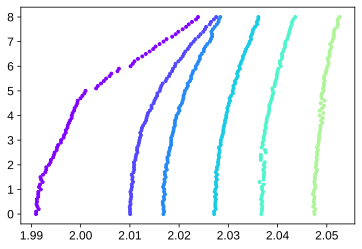

In [82]:
plt.figure(figsize=(6, 4))

N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

minT, maxT = 1, 23

plt.plot(peaknu_W3_half_B_1K_2[:], Bfield[:], ".", color = cs[int((1-1)/(maxT-minT)*999)], label = '1K') 
plt.plot(peaknu_W3_half_B_3K_2[:], Bfield[:], ".", color = cs[int((3-1)/(maxT-minT)*999)], label = '3K')
plt.plot(peaknu_W3_half_B_5K_2[:], Bfield[:], ".", color = cs[int((5-1)/(maxT-minT)*999)], label = '5K')
plt.plot(peaknu_W3_half_B_7p5K_2[:], Bfield[:], ".", color = cs[int((7.5-1)/(maxT-minT)*999)], label = '7.5K')
plt.plot(peaknu_W3_half_B_10K_2[:], Bfield[:], ".", color = cs[int((10-1)/(maxT-minT)*999)], label = '10K')
plt.plot(peaknu_W3_half_B_14K_2[:], Bfield[:], ".", color = cs[int((14-1)/(maxT-minT)*999)], label = '14K')
plt.plot(peaknu_W3_half_B_18K_2[:], Bfield[:], ".", color = cs[int((18-1)/(maxT-minT)*999)], label = '18K')



plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xlim(1.98, 2.08)
plt.ylim(0,8)
plt.axis()
plt.legend(frameon=False)

In [83]:
temps[135]

23.0

In [84]:
temps_W3_3D_0T = np.zeros(137-20)
peaknu_half_Tsweep_W3_3D_0T = np.zeros(137-20)
for i in range(137-20):
    temps_W3_3D_0T[i] =  temps[19+i]
    peaknu_half_Tsweep_W3_3D_0T[i] =  peaknu_W3_half_Tsweep_2[19+i]

In [85]:
temps_W3_3D_5T = np.zeros(137-20)
peaknu_half_Tsweep_W3_3D_5T = np.zeros(137-20)
for i in range(137-20):
    temps_W3_3D_5T[i] =  temps_5T[19+i]
    peaknu_half_Tsweep_W3_3D_5T[i] =  peaknu_W3_half_Tsweep_5T_2[19+i]

In [86]:
temps_W3_3D_8T = np.zeros(137-20)
peaknu_half_Tsweep_W3_3D_8T = np.zeros(137-20)
for i in range(137-20):
    temps_W3_3D_8T[i] =  temps_8T[19+i]
    peaknu_half_Tsweep_W3_3D_8T[i] =  peaknu_W3_half_Tsweep_8T_2[19+i]

In [87]:
temps_W3_3D_0T[-1]

23.0

In [88]:
peaknu_half_Tsweep_W3_3D_0T

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 2.00735448, 2.00790985, 2.00799189, 2.00860848,
       2.00857891, 2.01054671, 2.01086097, 2.01090274, 2.01093576,
       2.01102072, 2.0110864 , 2.0112855 , 2.01124213, 2.01144096,
       2.01150192, 2.01165605, 2.01137235, 2.01163386, 2.01184656,
       2.01200216, 2.01204134, 2.01247937, 2.01269747, 2.01265787,
       2.01301859, 2.01314217, 2.01318882, 2.01352216, 2.01375902,
       2.01429813, 2.0146088 , 2.0149292 , 2.01527841, 2.01555024,
       2.01589702, 2.0164038 , 2.01694889, 2.01714616, 2.01758061,
       2.01841125, 2.01851115, 2.01897339, 2.01922037, 2.02021064,
       2.02053006, 2.02101907, 2.021617  , 2.02185797, 2.02250855,
       2.02308217, 2.02344966, 2.02399496, 2.02441947, 2.02453399,
       2.02496592, 2.02525622, 2.02598184, 2.02659136, 2.02681161,
       2.02758058, 2.02817647, 2.02851952, 2.0290441 , 2.02967

Text(0, 0.5, 'T (K)')

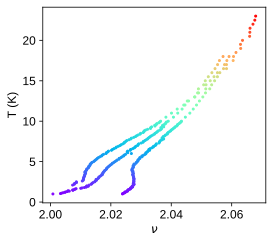

In [89]:
N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

plt.figure(figsize=(4, 3.6))

for i in range(11, 137-20):
    plt.plot(peaknu_half_Tsweep_W3_3D_0T[i], temps_W3_3D_0T[i], '.', color = cs[int((temps_W3_3D_0T[i]-1)/(maxT-minT)*999)], markersize = 4)
    
for i in range(137-20):
    plt.plot(peaknu_half_Tsweep_W3_3D_5T[i], temps_W3_3D_5T[i], '.', color = cs[int((temps_W3_3D_5T[i]-1)/(maxT-minT)*999)], markersize = 4) 
    
for i in range(137-20):
    plt.plot(peaknu_half_Tsweep_W3_3D_8T[i], temps_W3_3D_8T[i], '.', color = cs[int((temps_W3_3D_8T[i]-1)/(maxT-minT)*999)], markersize = 4)  

plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

#plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

In [90]:
Bfield[50]

5.0

NameError: name 'peaknu_W3_half_B_18K_2' is not defined

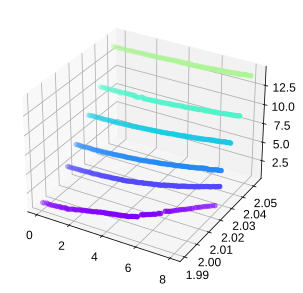

In [91]:
fig = plt.figure(figsize=(6, 5))
ax = plt.axes(projection='3d')

ax.scatter3D(Bfield[:], peaknu_W3_half_B_1K_2[:], np.full((81), 1), ".",color = cs[int((1-1)/(maxT-minT)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_half_B_3K_2[:], np.full((81), 3), ".",color = cs[int((3-1)/(maxT-minT)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_half_B_5K_2[:], np.full((81), 5), ".",color = cs[int((5-1)/(maxT-minT)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_half_B_7p5K_2[:], np.full((81), 7.5), ".",color = cs[int((7.5-1)/(maxT-minT)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_half_B_10K_2[:], np.full((81), 10), ".",color = cs[int((10-1)/(maxT-minT)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_half_B_14K_2[:], np.full((81), 14), ".",color = cs[int((14-1)/(maxT-minT)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_half_B_18K_2[:], np.full((81), 18), ".",color = cs[int((18-1)/(maxT-minT)*999)]);

for i in range(11, 137-20):
    ax.scatter3D(Bfield[0], peaknu_half_Tsweep_W3_3D_0T[i], temps_W3_3D_0T[i], '.', color = cs[int((temps_W3_3D_0T[i]-1)/(maxT-minT)*999)]) 
    
for i in range(137-20):
    ax.scatter3D(Bfield[50], peaknu_half_Tsweep_W3_3D_5T[i], temps_W3_3D_5T[i], '.', color = cs[int((temps_W3_3D_5T[i]-1)/(maxT-minT)*999)])
    
for i in range(137-20):
    ax.scatter3D(Bfield[80], peaknu_half_Tsweep_W3_3D_8T[i], temps_W3_3D_8T[i], '.', color = cs[int((temps_W3_3D_8T[i]-1)/(maxT-minT)*999)]) 




ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

ax.set_xlabel(r'$B_{\parallel}$ (T)')
ax.set_ylabel(r'$\nu$')
ax.set_zlabel('T (K)');

ax.set_xticks([0, 2, 4, 6, 8])
ax.set_yticks([2, 2.02, 2.04, 2.06])

#plt.savefig(figfile + 'S3_0p88_halffilling 3D.svg', dpi=300, bbox_inches='tight')

## W3 half filling peaks entropy fitting

output data and fit with matlab, just use the B field data at different T for fitting

In [368]:
scipy.io.savemat('W3half1K.mat', dict(b1=Bfield, W3_halffilling_1=peaknu_W3_half_B_1K_2))

In [369]:
scipy.io.savemat('W3half3K.mat', dict(b2=Bfield, W3_halffilling_2=peaknu_W3_half_B_3K_2))

In [370]:
scipy.io.savemat('W3half5K.mat', dict(b3=Bfield, W3_halffilling_3=peaknu_W3_half_B_5K_2))

In [371]:
scipy.io.savemat('W3half7p5K.mat', dict(b4=Bfield, W3_halffilling_4=peaknu_W3_half_B_7p5K_2))

In [372]:
scipy.io.savemat('W3half10K.mat', dict(b5=Bfield, W3_halffilling_5=peaknu_W3_half_B_10K_2))

In [373]:
scipy.io.savemat('W3half14K.mat', dict(b6=Bfield, W3_halffilling_6=peaknu_W3_half_B_14K_2))

In [374]:
scipy.io.savemat('W3half18K.mat', dict(b7=Bfield, W3_halffilling_7=peaknu_W3_half_B_18K_2))

fitting (1 K 3K 5K 7.5K 10K 14K 18K) use the following formula:


$\nu$ =  1 / ( u ) * ( e - ( g ) * T^2 / 2 + T * log ( 2 * cosh ( 0.671713 * B / T ) ) )

where 0.671713 is $\mu_{B}$/$k_{B}$

u = $\mu_{2}$ - $\mu_{1}$

e = $e_{2}$ - $e_{1}$

g = $\gamma_{2}$ - $\gamma_{1}$

with the help of matlab here are the result:

u = 127.4  (122.2, 132.7)

g = 0.02328  (0.02157, 0.02498)

e = 253.3  (242.8, 263.8)

Goodness of fit:

SSE: 0.008585

R-square: 0.9555

Adjusted R-square: 0.9554

RMSE: 0.003901

In [381]:
u = 127.4
e = 253.3
g = 0.02328
def f(T, B):
    return 1/(u)*(e - (g)*T**2 / 2 + 1*T * np.log(2*np.cosh(0.671713*B/T)))

t = np.linspace(1, 18, 20)
b = np.linspace(0, 8, 16)

T, B = np.meshgrid(t, b)
Z = f(T, B)

In [382]:
T2 = np.linspace(1, 18, 1000)
B2 = np.linspace(0,8,10)

In [383]:
T3 = np.linspace(1, 18, 10)
B3 = np.linspace(0,8,1000)

In [384]:
fig = plt.figure(figsize=(5, 5))
ax = plt.axes(projection='3d')

for i in range(len(B2)):
    for j in range(len(T2)):
        ax.scatter(B2[i], 1/(u)*(e - (g)*T2[j]**2 / 2 + 1*T2[j] * np.log(2*np.cosh(0.671713*B2[i]/T2[j]))), T2[j], '.', color = cs[int((T2[j]-1)/(maxT-minT)*999)], s=1)
        
for i in range(len(T3)):
    for j in range(len(B3)):
        ax.scatter(B3[j], 1/(u)*(e - (g)*T3[i]**2 / 2 + 1*T3[i] * np.log(2*np.cosh(0.671713*B3[j]/T3[i]))), T3[i], '.', color = cs[int((T3[i]-1)/(maxT-minT)*999)], s=1)
        


ax.set_xlabel('B (T)')
ax.set_ylabel(r'$\nu$')
ax.set_zlabel('T (K)');

ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

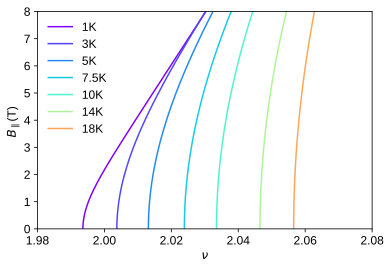

In [385]:
plt.figure(figsize=(6, 4))

N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

plt.plot(1/(u)*(e - (g)*1**2 / 2 + 1*1 * np.log(2*np.cosh(0.671713*Bfield[:]/1))), Bfield[:], color = cs[int((1-1)/(maxT-minT)*999)], label = '1K')
plt.plot(1/(u)*(e - (g)*3**2 / 2 + 1*3 * np.log(2*np.cosh(0.671713*Bfield[:]/3))), Bfield[:], color = cs[int((3-1)/(maxT-minT)*999)], label = '3K')
plt.plot(1/(u)*(e - (g)*5**2 / 2 + 1*5 * np.log(2*np.cosh(0.671713*Bfield[:]/5))), Bfield[:], color = cs[int((5-1)/(maxT-minT)*999)], label = '5K')
plt.plot(1/(u)*(e - (g)*7.5**2 / 2 + 1*7.5 * np.log(2*np.cosh(0.671713*Bfield[:]/7.5))), Bfield[:], color = cs[int((7.5-1)/(maxT-minT)*999)], label = '7.5K')
plt.plot(1/(u)*(e - (g)*10**2 / 2 + 1*10 * np.log(2*np.cosh(0.671713*Bfield[:]/10))), Bfield[:], color = cs[int((10-1)/(maxT-minT)*999)], label = '10K')
plt.plot(1/(u)*(e - (g)*14**2 / 2 + 1*14 * np.log(2*np.cosh(0.671713*Bfield[:]/14))), Bfield[:], color = cs[int((14-1)/(maxT-minT)*999)], label = '14K')
plt.plot(1/(u)*(e - (g)*18**2 / 2 + 1*18 * np.log(2*np.cosh(0.671713*Bfield[:]/18))), Bfield[:], color = cs[int((18-1)/(maxT-minT)*999)], label = '18K')

plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xlim(1.98, 2.08)
plt.ylim(0,8)
plt.axis()
plt.legend(frameon=False)

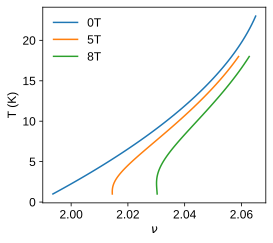

In [386]:
plt.figure(figsize=(4, 3.6))

plt.plot(1/(u)*(e - (g)*temps_W3_3D_0T[:]**2 / 2 + 1*temps_W3_3D_0T[:] * np.log(2*np.cosh(0.671713*0/temps_W3_3D_0T[:]))), temps_W3_3D_0T[:], label = '0T')
plt.plot(1/(u)*(e - (g)*temps_W3_3D_5T[:]**2 / 2 + 1*temps_W3_3D_5T[:] * np.log(2*np.cosh(0.671713*5/temps_W3_3D_5T[:]))), temps_W3_3D_5T[:], label = '5T')
plt.plot(1/(u)*(e - (g)*temps_W3_3D_8T[:]**2 / 2 + 1*temps_W3_3D_8T[:] * np.log(2*np.cosh(0.671713*8/temps_W3_3D_8T[:]))), temps_W3_3D_8T[:], label = '8T')

plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

plt.axis()
plt.legend(frameon=False)

## W3 T and B dependence minus quarter filling peaks together

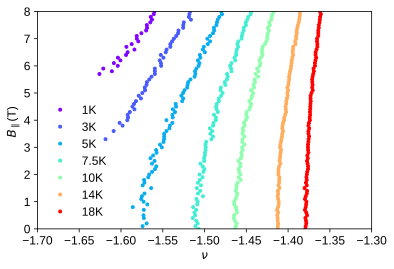

In [156]:
plt.figure(figsize=(6, 4))

N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

plt.plot(peaknu_W3_mquarter_B_1K_2[:], Bfield[:], ".", color = cs[int((1-1)/(18-1)*999)], label = '1K') 
plt.plot(peaknu_W3_mquarter_B_3K_2[:], Bfield[:], ".", color = cs[int((3-1)/(18-1)*999)], label = '3K')
plt.plot(peaknu_W3_mquarter_B_5K_2[:], Bfield[:], ".", color = cs[int((5-1)/(18-1)*999)], label = '5K')
plt.plot(peaknu_W3_mquarter_B_7p5K_2[:], Bfield[:], ".", color = cs[int((7.5-1)/(18-1)*999)], label = '7.5K')
plt.plot(peaknu_W3_mquarter_B_10K_2[:], Bfield[:], ".", color = cs[int((10-1)/(18-1)*999)], label = '10K')
plt.plot(peaknu_W3_mquarter_B_14K_2[:], Bfield[:], ".", color = cs[int((14-1)/(18-1)*999)], label = '14K')
plt.plot(peaknu_W3_mquarter_B_18K_2[:], Bfield[:], ".", color = cs[int((18-1)/(18-1)*999)], label = '18K')



plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xlim(-1.7, -1.3)
plt.ylim(0,8)
plt.axis()
plt.legend(frameon=False)

In [845]:
temps_5T[50]

3.1

In [846]:
temps_W3_3D_0T = np.zeros(137-65)
peaknu_mquarter_Tsweep_W3_3D_0T = np.zeros(137-65)
for i in range(137-65):
    temps_W3_3D_0T[i] =  temps[64+i]
    peaknu_mquarter_Tsweep_W3_3D_0T[i] =  peaknu_W3_mquarter_Tsweep_2[64+i]

In [847]:
temps_W3_3D_5T = np.zeros(137-51)
peaknu_mquarter_Tsweep_W3_3D_5T = np.zeros(137-51)
for i in range(137-51):
    temps_W3_3D_5T[i] =  temps_5T[50+i]
    peaknu_mquarter_Tsweep_W3_3D_5T[i] =  peaknu_W3_mquarter_Tsweep_5T_2[50+i]

In [860]:
temps_W3_3D_8T = np.zeros(137-20)
peaknu_mquarter_Tsweep_W3_3D_8T = np.zeros(137-20)
for i in range(137-20):
    temps_W3_3D_8T[i] =  temps_8T[19+i]
    peaknu_mquarter_Tsweep_W3_3D_8T[i] =  peaknu_W3_mquarter_Tsweep_8T_2[19+i]

<IPython.core.display.Javascript object>


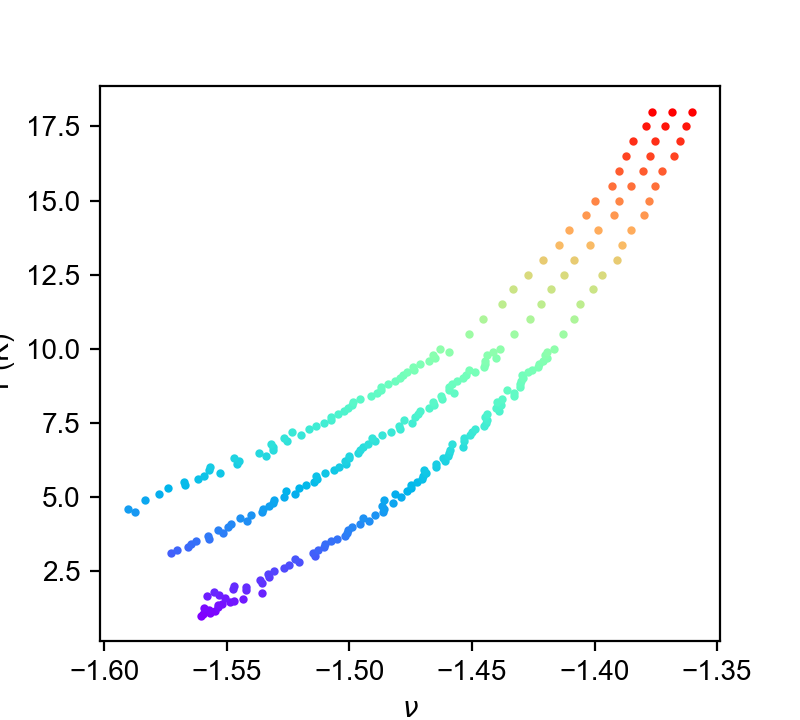

Text(0, 0.5, 'T (K)')

In [876]:
N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

plt.figure(figsize=(4, 3.6))

for i in range(137-65):
    plt.plot(peaknu_mquarter_Tsweep_W3_3D_0T[i], temps_W3_3D_0T[i], '.', color = cs[int((temps_W3_3D_0T[i]-1)/(18-1)*999)], markersize = 4)
    
for i in range(137-51):
    plt.plot(peaknu_mquarter_Tsweep_W3_3D_5T[i], temps_W3_3D_5T[i], '.', color = cs[int((temps_W3_3D_5T[i]-1)/(18-1)*999)], markersize = 4) 
    
for i in range(137-20):
    plt.plot(peaknu_mquarter_Tsweep_W3_3D_8T[i], temps_W3_3D_8T[i], '.', color = cs[int((temps_W3_3D_8T[i]-1)/(18-1)*999)], markersize = 4)  

plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

#plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

<IPython.core.display.Javascript object>


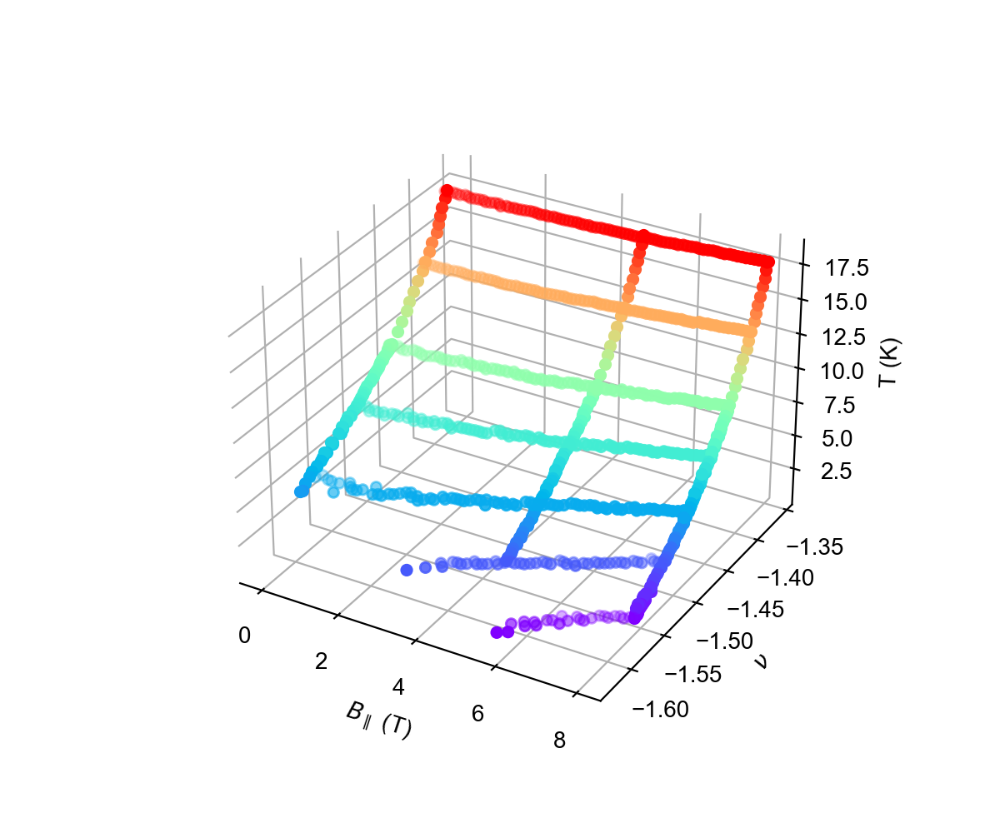

In [862]:
fig = plt.figure(figsize=(6, 5))
ax = plt.axes(projection='3d')

ax.scatter3D(Bfield[:], peaknu_W3_mquarter_B_1K_2[:], np.full((81), 1), ".",color = cs[int((1-1)/(18-1)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mquarter_B_3K_2[:], np.full((81), 3), ".",color = cs[int((3-1)/(18-1)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mquarter_B_5K_2[:], np.full((81), 5), ".",color = cs[int((5-1)/(18-1)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mquarter_B_7p5K_2[:], np.full((81), 7.5), ".",color = cs[int((7.5-1)/(18-1)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mquarter_B_10K_2[:], np.full((81), 10), ".",color = cs[int((10-1)/(18-1)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mquarter_B_14K_2[:], np.full((81), 14), ".",color = cs[int((14-1)/(18-1)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mquarter_B_18K_2[:], np.full((81), 18), ".",color = cs[int((18-1)/(18-1)*999)]);

for i in range(137-65):
    ax.scatter3D(Bfield[0], peaknu_mquarter_Tsweep_W3_3D_0T[i], temps_W3_3D_0T[i], '.', color = cs[int((temps_W3_3D_0T[i]-1)/(18-1)*999)]) 
    
for i in range(137-51):
    ax.scatter3D(Bfield[50], peaknu_mquarter_Tsweep_W3_3D_5T[i], temps_W3_3D_5T[i], '.', color = cs[int((temps_W3_3D_5T[i]-1)/(18-1)*999)])
    
for i in range(137-20):
    ax.scatter3D(Bfield[80], peaknu_mquarter_Tsweep_W3_3D_8T[i], temps_W3_3D_8T[i], '.', color = cs[int((temps_W3_3D_8T[i]-1)/(18-1)*999)]) 




ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

ax.set_xlabel(r'$B_{\parallel}$ (T)')
ax.set_ylabel(r'$\nu$')
ax.set_zlabel('T (K)');

ax.set_xticks([0, 2, 4, 6, 8])
#ax.set_yticks([2, 2.02, 2.04, 2.06])

#plt.savefig(figfile + 'S3_0p88_halffilling 3D.svg', dpi=300, bbox_inches='tight')

## W3 minus quarter filling peaks entropy fitting

In [864]:
scipy.io.savemat('W3mquarter1K.mat', dict(b1=Bfield, W3_mquarterfilling_1=peaknu_W3_mquarter_B_1K_2))

In [865]:
scipy.io.savemat('W3mquarter3K.mat', dict(b2=Bfield, W3_mquarterfilling_2=peaknu_W3_mquarter_B_3K_2))

In [866]:
scipy.io.savemat('W3mquarter5K.mat', dict(b3=Bfield, W3_mquarterfilling_3=peaknu_W3_mquarter_B_5K_2))

In [867]:
scipy.io.savemat('W3mquarter7p5K.mat', dict(b4=Bfield, W3_mquarterfilling_4=peaknu_W3_mquarter_B_7p5K_2))

In [868]:
scipy.io.savemat('W3mquarter10K.mat', dict(b5=Bfield, W3_mquarterfilling_5=peaknu_W3_mquarter_B_10K_2))

In [869]:
scipy.io.savemat('W3mquarter14K.mat', dict(b6=Bfield, W3_mquarterfilling_6=peaknu_W3_mquarter_B_14K_2))

In [870]:
scipy.io.savemat('W3mquarter18K.mat', dict(b7=Bfield, W3_mquarterfilling_7=peaknu_W3_mquarter_B_18K_2))

fitting (1 K 3K 5K 7.5K 10K 14K 18K) use the following formula:


$\nu$ =  -1 / ( u ) * ( e - ( g ) * T^2 / 2 - T * log ( 2 * cosh ( 0.671713 * B / T ) ) )

where 0.671713 is $\mu_{B}$/$k_{B}$

u = $\mu_{2}$ - $\mu_{1}$

e = $e_{2}$ - $e_{1}$

g = $\gamma_{2}$ - $\gamma_{1}$

with the help of matlab here are the result:

u = 25.48  (23.75, 27.22)

g = -0.02582  (-0.02795, -0.02368)

e = 43.33  (40.66, 45.99)

Goodness of fit:

SSE: 0.1687

R-square: 0.9285

Adjusted R-square: 0.9282

RMSE: 0.019


In [872]:
u = 25.48
e = 43.33
g = -0.02582
def f(T, B):
    return -1/(u)*(e - (g)*T**2 / 2 - 1*T * np.log(2*np.cosh(0.671713*B/T)))

t = np.linspace(1, 18, 20)
b = np.linspace(0, 8, 16)

T, B = np.meshgrid(t, b)
Z = f(T, B)

In [873]:
T2 = np.linspace(1, 18, 1000)
B2 = np.linspace(0,8,10)

In [874]:
T3 = np.linspace(1, 18, 10)
B3 = np.linspace(0,8,1000)

<IPython.core.display.Javascript object>


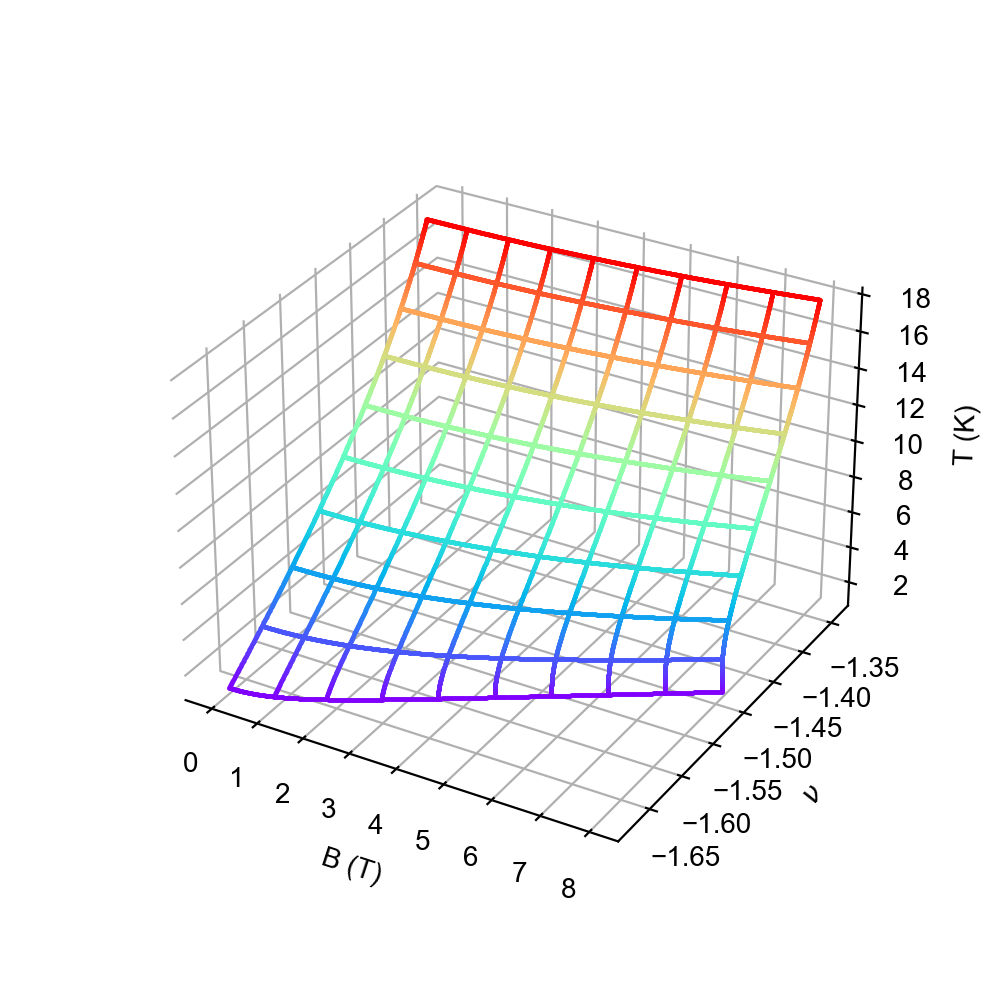

In [875]:
fig = plt.figure(figsize=(5, 5))
ax = plt.axes(projection='3d')

for i in range(len(B2)):
    for j in range(len(T2)):
        ax.scatter(B2[i], -1/(u)*(e - (g)*T2[j]**2 / 2 - 1*T2[j] * np.log(2*np.cosh(0.671713*B2[i]/T2[j]))), T2[j], '.', color = cs[int((T2[j]-1)/(18-1)*999)], s=1)
        
for i in range(len(T3)):
    for j in range(len(B3)):
        ax.scatter(B3[j], -1/(u)*(e - (g)*T3[i]**2 / 2 - 1*T3[i] * np.log(2*np.cosh(0.671713*B3[j]/T3[i]))), T3[i], '.', color = cs[int((T3[i]-1)/(18-1)*999)], s=1)
        


ax.set_xlabel('B (T)')
ax.set_ylabel(r'$\nu$')
ax.set_zlabel('T (K)');

ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

<IPython.core.display.Javascript object>


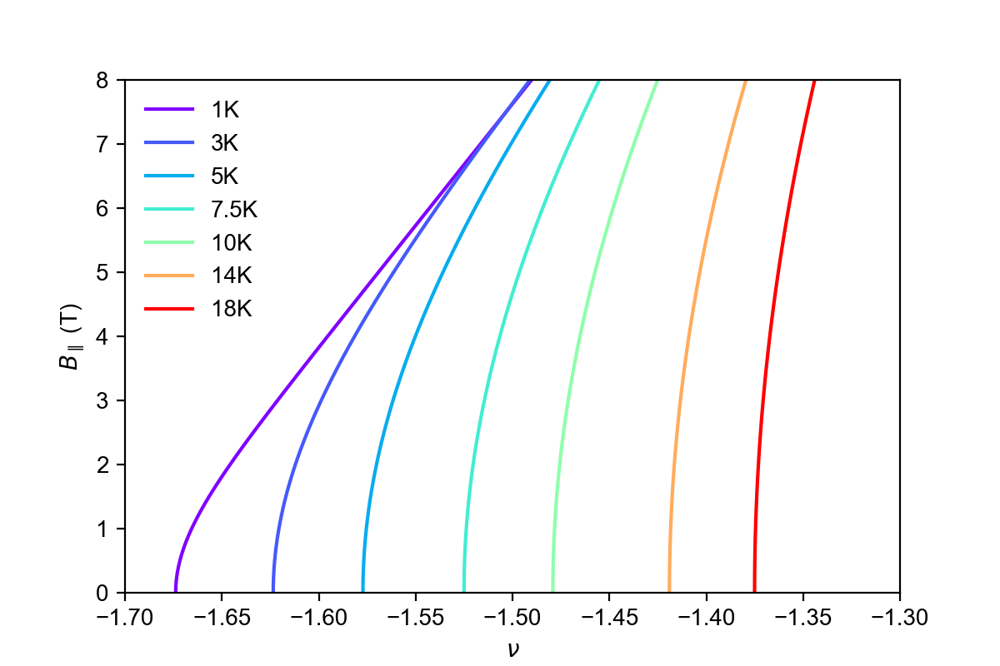

In [880]:
plt.figure(figsize=(6, 4))

N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

plt.plot(-1/(u)*(e - (g)*1**2 / 2 - 1*1 * np.log(2*np.cosh(0.671713*Bfield[:]/1))), Bfield[:], color = cs[int((1-1)/(18-1)*999)], label = '1K')
plt.plot(-1/(u)*(e - (g)*3**2 / 2 - 1*3 * np.log(2*np.cosh(0.671713*Bfield[:]/3))), Bfield[:], color = cs[int((3-1)/(18-1)*999)], label = '3K')
plt.plot(-1/(u)*(e - (g)*5**2 / 2 - 1*5 * np.log(2*np.cosh(0.671713*Bfield[:]/5))), Bfield[:], color = cs[int((5-1)/(18-1)*999)], label = '5K')
plt.plot(-1/(u)*(e - (g)*7.5**2 / 2 - 1*7.5 * np.log(2*np.cosh(0.671713*Bfield[:]/7.5))), Bfield[:], color = cs[int((7.5-1)/(18-1)*999)], label = '7.5K')
plt.plot(-1/(u)*(e - (g)*10**2 / 2 - 1*10 * np.log(2*np.cosh(0.671713*Bfield[:]/10))), Bfield[:], color = cs[int((10-1)/(18-1)*999)], label = '10K')
plt.plot(-1/(u)*(e - (g)*14**2 / 2 - 1*14 * np.log(2*np.cosh(0.671713*Bfield[:]/14))), Bfield[:], color = cs[int((14-1)/(18-1)*999)], label = '14K')
plt.plot(-1/(u)*(e - (g)*18**2 / 2 - 1*18 * np.log(2*np.cosh(0.671713*Bfield[:]/18))), Bfield[:], color = cs[int((18-1)/(18-1)*999)], label = '18K')

plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xlim(-1.7, -1.3)
plt.ylim(0,8)
plt.axis()
plt.legend(frameon=False)

<IPython.core.display.Javascript object>


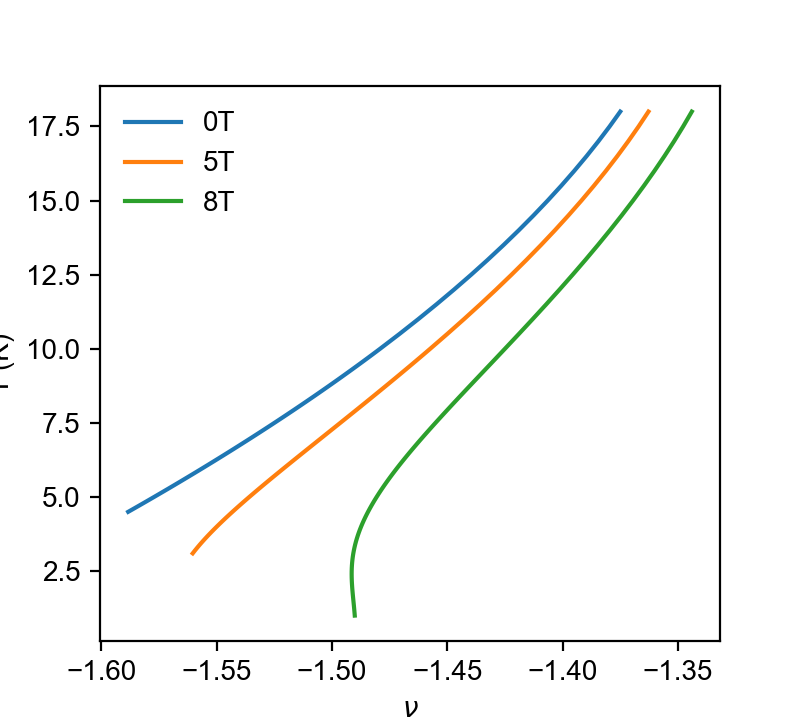

In [881]:
plt.figure(figsize=(4, 3.6))

plt.plot(-1/(u)*(e - (g)*temps_W3_3D_0T[:]**2 / 2 - 1*temps_W3_3D_0T[:] * np.log(2*np.cosh(0.671713*0/temps_W3_3D_0T[:]))), temps_W3_3D_0T[:], label = '0T')
plt.plot(-1/(u)*(e - (g)*temps_W3_3D_5T[:]**2 / 2 - 1*temps_W3_3D_5T[:] * np.log(2*np.cosh(0.671713*5/temps_W3_3D_5T[:]))), temps_W3_3D_5T[:], label = '5T')
plt.plot(-1/(u)*(e - (g)*temps_W3_3D_8T[:]**2 / 2 - 1*temps_W3_3D_8T[:] * np.log(2*np.cosh(0.671713*8/temps_W3_3D_8T[:]))), temps_W3_3D_8T[:], label = '8T')

plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

plt.axis()
plt.legend(frameon=False)

## W3 T and B dependence minus half filling peaks together

<IPython.core.display.Javascript object>


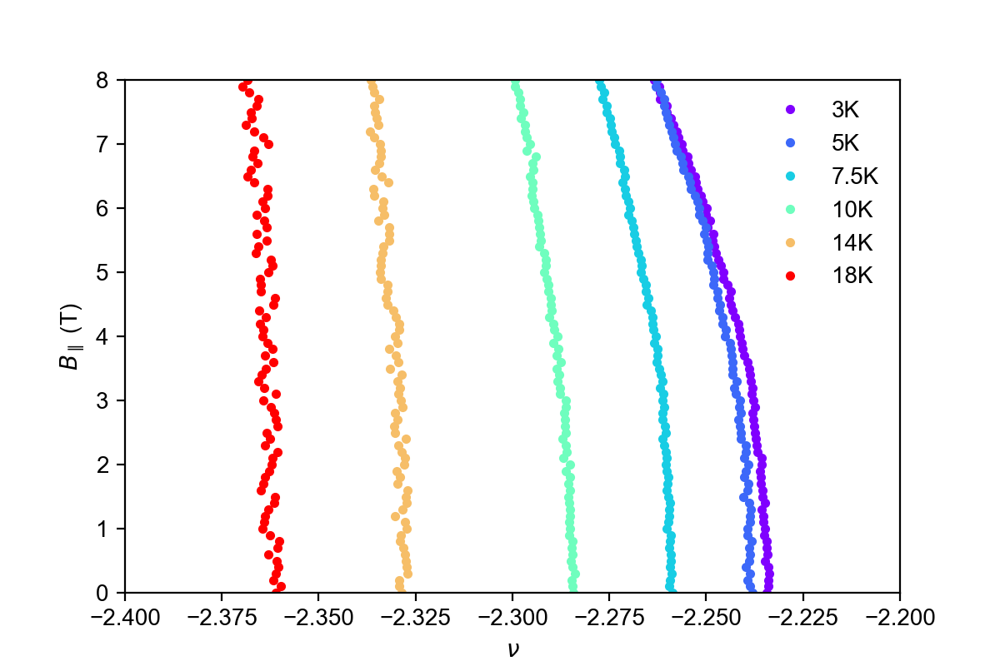

In [885]:
plt.figure(figsize=(6, 4))

N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))
 
plt.plot(peaknu_W3_mhalf_B_3K_2[:], Bfield[:], ".", color = cs[int((3-3)/(18-3)*999)], label = '3K')
plt.plot(peaknu_W3_mhalf_B_5K_2[:], Bfield[:], ".", color = cs[int((5-3)/(18-3)*999)], label = '5K')
plt.plot(peaknu_W3_mhalf_B_7p5K_2[:], Bfield[:], ".", color = cs[int((7.5-3)/(18-3)*999)], label = '7.5K')
plt.plot(peaknu_W3_mhalf_B_10K_2[:], Bfield[:], ".", color = cs[int((10-3)/(18-3)*999)], label = '10K')
plt.plot(peaknu_W3_mhalf_B_14K_2[:], Bfield[:], ".", color = cs[int((14-3)/(18-3)*999)], label = '14K')
plt.plot(peaknu_W3_mhalf_B_18K_2[:], Bfield[:], ".", color = cs[int((18-3)/(18-3)*999)], label = '18K')



plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xlim(-2.4, -2.2)
plt.ylim(0,8)
plt.axis()
plt.legend(frameon=False)

In [921]:
temps_W3_3D_0T = np.zeros(137-50)
peaknu_mhalf_Tsweep_W3_3D_0T = np.zeros(137-50)
for i in range(137-50):
    temps_W3_3D_0T[i] =  temps[49+i]
    peaknu_mhalf_Tsweep_W3_3D_0T[i] =  peaknu_W3_mhalf_Tsweep_2[49+i]

In [923]:
temps_W3_3D_5T = np.zeros(137-50)
peaknu_mhalf_Tsweep_W3_3D_5T = np.zeros(137-50)
for i in range(137-50):
    temps_W3_3D_5T[i] =  temps_5T[49+i]
    peaknu_mhalf_Tsweep_W3_3D_5T[i] =  peaknu_W3_mhalf_Tsweep_5T_2[49+i]

In [924]:
temps_W3_3D_8T = np.zeros(137-50)
peaknu_mhalf_Tsweep_W3_3D_8T = np.zeros(137-50)
for i in range(137-50):
    temps_W3_3D_8T[i] =  temps_8T[49+i]
    peaknu_mhalf_Tsweep_W3_3D_8T[i] =  peaknu_W3_mhalf_Tsweep_8T_2[49+i]

<IPython.core.display.Javascript object>


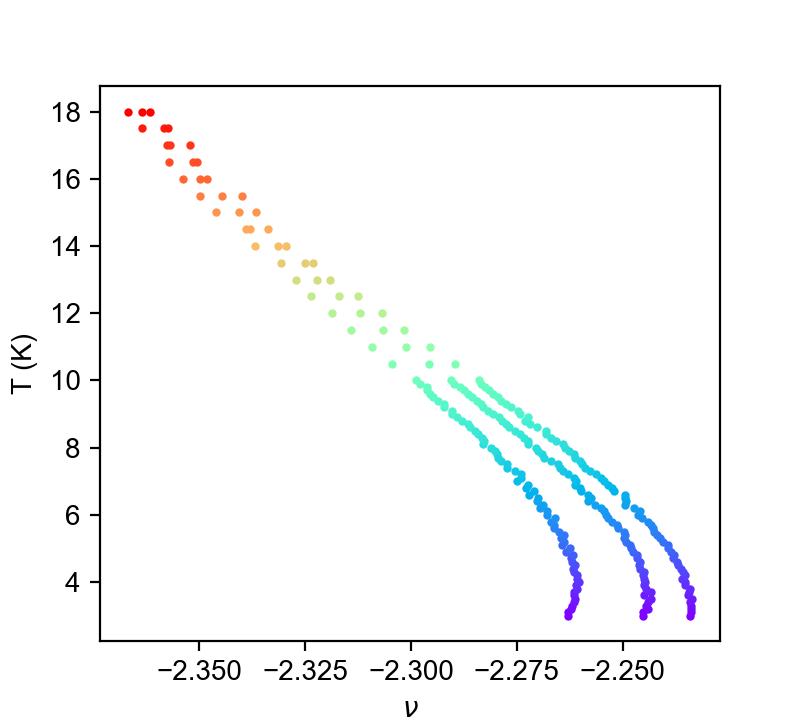

Text(0, 0.5, 'T (K)')

In [926]:
N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

plt.figure(figsize=(4, 3.6))

for i in range(137-50):
    plt.plot(peaknu_mhalf_Tsweep_W3_3D_0T[i], temps_W3_3D_0T[i], '.', color = cs[int((temps_W3_3D_0T[i]-3)/(18-3)*999)], markersize = 4)
    
for i in range(137-50):
    plt.plot(peaknu_mhalf_Tsweep_W3_3D_5T[i], temps_W3_3D_5T[i], '.', color = cs[int((temps_W3_3D_5T[i]-3)/(18-3)*999)], markersize = 4) 
    
for i in range(137-50):
    plt.plot(peaknu_mhalf_Tsweep_W3_3D_8T[i], temps_W3_3D_8T[i], '.', color = cs[int((temps_W3_3D_8T[i]-3)/(18-3)*999)], markersize = 4)  

plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

#plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
#plt.savefig(figfile + 'S3_0p88_to25K.svg', dpi=300, bbox_inches='tight')

<IPython.core.display.Javascript object>


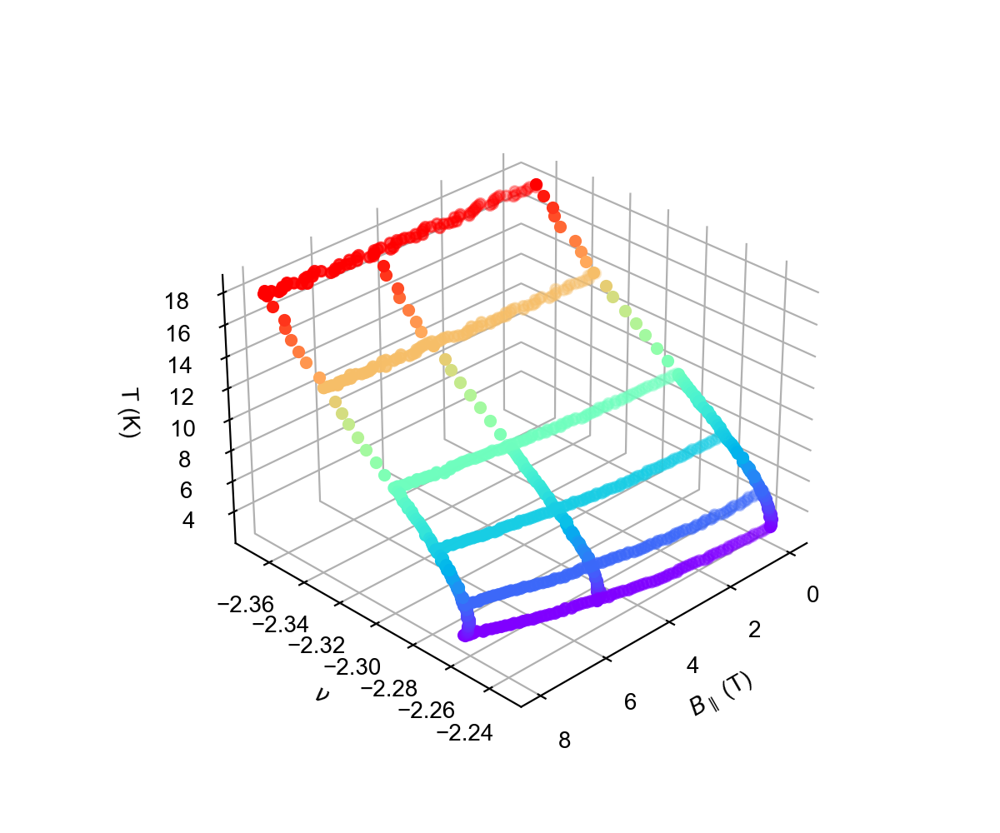

In [925]:
fig = plt.figure(figsize=(6, 5))
ax = plt.axes(projection='3d')

ax.scatter3D(Bfield[:], peaknu_W3_mhalf_B_3K_2[:], np.full((81), 3), ".",color = cs[int((3-3)/(18-3)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mhalf_B_5K_2[:], np.full((81), 5), ".",color = cs[int((5-3)/(18-3)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mhalf_B_7p5K_2[:], np.full((81), 7.5), ".",color = cs[int((7.5-3)/(18-3)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mhalf_B_10K_2[:], np.full((81), 10), ".",color = cs[int((10-3)/(18-3)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mhalf_B_14K_2[:], np.full((81), 14), ".",color = cs[int((14-3)/(18-3)*999)]);
ax.scatter3D(Bfield[:], peaknu_W3_mhalf_B_18K_2[:], np.full((81), 18), ".",color = cs[int((18-3)/(18-3)*999)]);

for i in range(137-50):
    ax.scatter(Bfield[0], peaknu_mhalf_Tsweep_W3_3D_0T[i], temps_W3_3D_0T[i], '.', color = cs[int((temps_W3_3D_0T[i]-3)/(18-3)*999)]) 
    
for i in range(137-50):
    ax.scatter(Bfield[50], peaknu_mhalf_Tsweep_W3_3D_5T[i], temps_W3_3D_5T[i], '.', color = cs[int((temps_W3_3D_5T[i]-3)/(18-3)*999)])
    
for i in range(137-50):
    ax.scatter(Bfield[80], peaknu_mhalf_Tsweep_W3_3D_8T[i], temps_W3_3D_8T[i], '.', color = cs[int((temps_W3_3D_8T[i]-3)/(18-3)*999)]) 




ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

ax.set_xlabel(r'$B_{\parallel}$ (T)')
ax.set_ylabel(r'$\nu$')
ax.set_zlabel('T (K)');

ax.set_xticks([0, 2, 4, 6, 8])
#ax.set_yticks([2, 2.02, 2.04, 2.06])

ax.view_init(azim=45)
#plt.savefig(figfile + 'S3_0p88_halffilling 3D.svg', dpi=300, bbox_inches='tight')

## W3 minus half filling peaks entropy fitting

In [927]:
scipy.io.savemat('W3mhalf3K.mat', dict(b1=Bfield, W3_mhalffilling_1=peaknu_W3_mhalf_B_3K_2))

In [928]:
scipy.io.savemat('W3mhalf5K.mat', dict(b2=Bfield, W3_mhalffilling_2=peaknu_W3_mhalf_B_5K_2))

In [929]:
scipy.io.savemat('W3mhalf7p5K.mat', dict(b3=Bfield, W3_mhalffilling_3=peaknu_W3_mhalf_B_7p5K_2))

In [930]:
scipy.io.savemat('W3mhalf10K.mat', dict(b4=Bfield, W3_mhalffilling_4=peaknu_W3_mhalf_B_10K_2))

In [931]:
scipy.io.savemat('W3mhalf14K.mat', dict(b5=Bfield, W3_mhalffilling_5=peaknu_W3_mhalf_B_14K_2))

In [932]:
scipy.io.savemat('W3mhalf18K.mat', dict(b6=Bfield, W3_mhalffilling_6=peaknu_W3_mhalf_B_18K_2))

fitting (3K 5K 7.5K 10K 14K 18K) use the following formula:


$\nu$ =  -1 / ( u ) * ( e - ( g ) * T^2 / 2 + T * log ( 2 * cosh ( 0.671713 * B / T ) ) )

where 0.671713 is $\mu_{B}$/$k_{B}$

u = $\mu_{2}$ - $\mu_{1}$

e = $e_{2}$ - $e_{1}$

g = $\gamma_{2}$ - $\gamma_{1}$

with the help of matlab here are the result:

u = 103.3  (98.69, 108)

g = -0.02367  (-0.02742, -0.01993)

e = 228  (217.6, 238.4)

Goodness of fit:

SSE: 0.007635

R-square: 0.9921

Adjusted R-square: 0.9921

RMSE: 0.003976

In [933]:
u = 103.3
e = 228
g = -0.02367
def f(T, B):
    return -1/(u)*(e - (g)*T**2 / 2 + 1*T * np.log(2*np.cosh(0.671713*B/T)))

t = np.linspace(3, 18, 20)
b = np.linspace(0, 8, 16)

T, B = np.meshgrid(t, b)
Z = f(T, B)

In [934]:
T2 = np.linspace(3, 18, 1000)
B2 = np.linspace(0,8,10)

In [935]:
T3 = np.linspace(3, 18, 10)
B3 = np.linspace(0,8,1000)

<IPython.core.display.Javascript object>


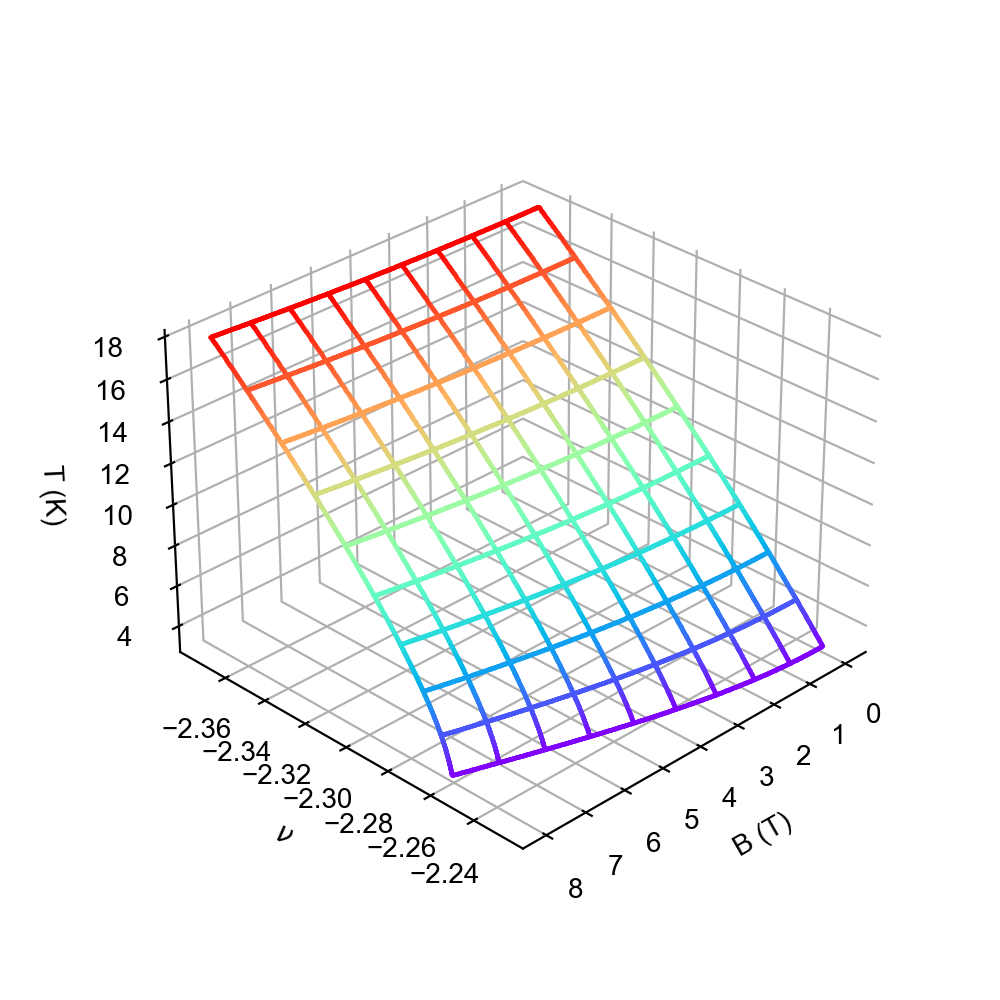

In [937]:
fig = plt.figure(figsize=(5, 5))
ax = plt.axes(projection='3d')

for i in range(len(B2)):
    for j in range(len(T2)):
        ax.scatter(B2[i], -1/(u)*(e - (g)*T2[j]**2 / 2 + 1*T2[j] * np.log(2*np.cosh(0.671713*B2[i]/T2[j]))), T2[j], '.', color = cs[int((T2[j]-3)/(18-3)*999)], s=1)
        
for i in range(len(T3)):
    for j in range(len(B3)):
        ax.scatter(B3[j], -1/(u)*(e - (g)*T3[i]**2 / 2 + 1*T3[i] * np.log(2*np.cosh(0.671713*B3[j]/T3[i]))), T3[i], '.', color = cs[int((T3[i]-3)/(18-3)*999)], s=1)
        


ax.set_xlabel('B (T)')
ax.set_ylabel(r'$\nu$')
ax.set_zlabel('T (K)');

ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
ax.view_init(azim=45)

<IPython.core.display.Javascript object>


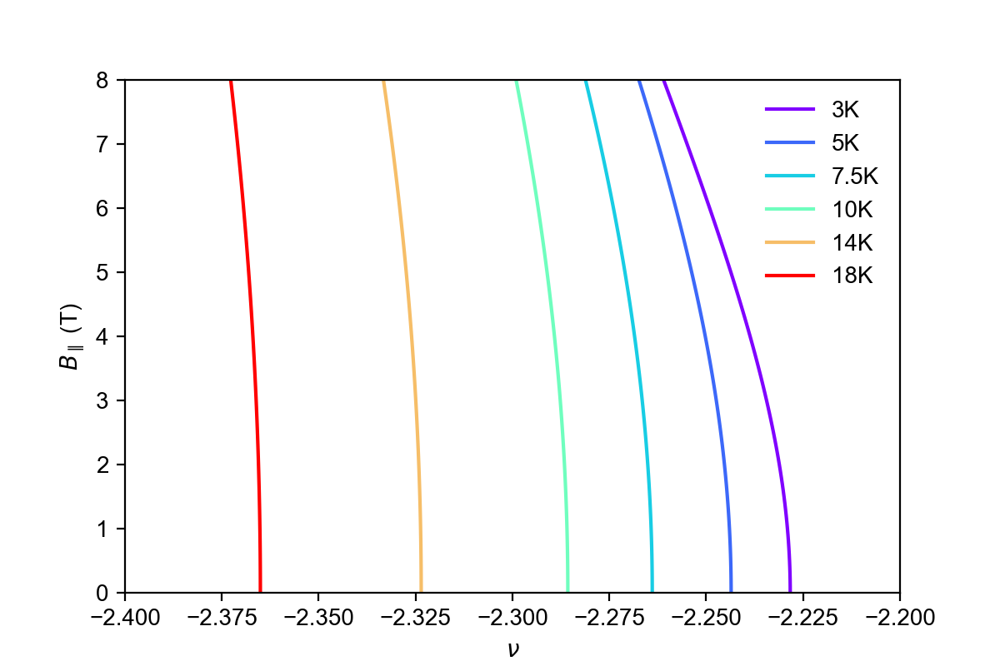

In [939]:
plt.figure(figsize=(6, 4))

N = 1000
cs = plt.get_cmap('rainbow')(np.linspace(0,1,N))

plt.plot(-1/(u)*(e - (g)*3**2 / 2 + 1*3 * np.log(2*np.cosh(0.671713*Bfield[:]/3))), Bfield[:], color = cs[int((3-3)/(18-3)*999)], label = '3K')
plt.plot(-1/(u)*(e - (g)*5**2 / 2 + 1*5 * np.log(2*np.cosh(0.671713*Bfield[:]/5))), Bfield[:], color = cs[int((5-3)/(18-3)*999)], label = '5K')
plt.plot(-1/(u)*(e - (g)*7.5**2 / 2 + 1*7.5 * np.log(2*np.cosh(0.671713*Bfield[:]/7.5))), Bfield[:], color = cs[int((7.5-3)/(18-3)*999)], label = '7.5K')
plt.plot(-1/(u)*(e - (g)*10**2 / 2 + 1*10 * np.log(2*np.cosh(0.671713*Bfield[:]/10))), Bfield[:], color = cs[int((10-3)/(18-3)*999)], label = '10K')
plt.plot(-1/(u)*(e - (g)*14**2 / 2 + 1*14 * np.log(2*np.cosh(0.671713*Bfield[:]/14))), Bfield[:], color = cs[int((14-3)/(18-3)*999)], label = '14K')
plt.plot(-1/(u)*(e - (g)*18**2 / 2 + 1*18 * np.log(2*np.cosh(0.671713*Bfield[:]/18))), Bfield[:], color = cs[int((18-3)/(18-3)*999)], label = '18K')

plt.xlabel(r'$\nu$')
plt.ylabel(r'$B_{\parallel}$ (T)')
plt.xlim(-2.4, -2.2)
plt.ylim(0,8)
plt.axis()
plt.legend(frameon=False)

<IPython.core.display.Javascript object>


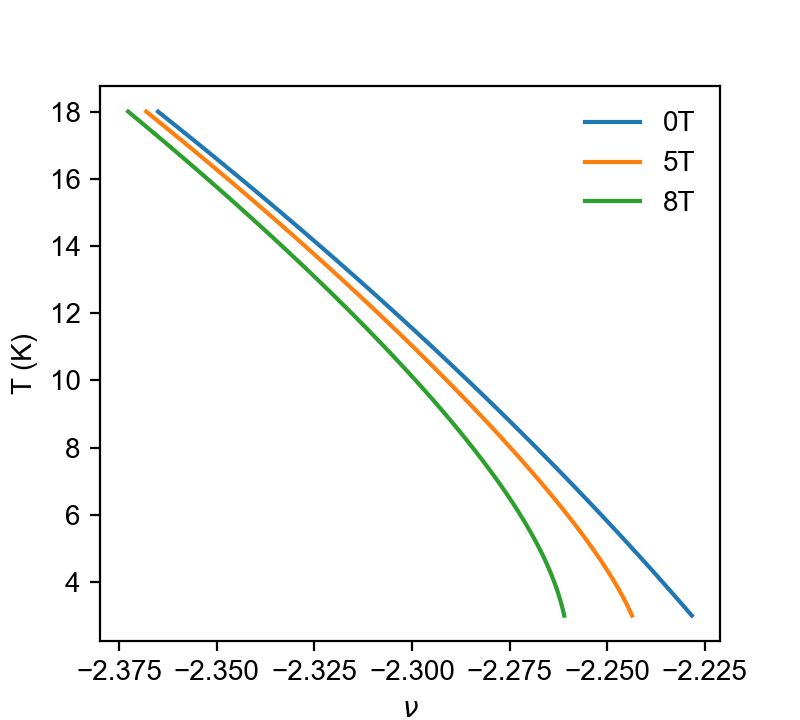

In [938]:
plt.figure(figsize=(4, 3.6))

plt.plot(-1/(u)*(e - (g)*temps_W3_3D_0T[:]**2 / 2 + 1*temps_W3_3D_0T[:] * np.log(2*np.cosh(0.671713*0/temps_W3_3D_0T[:]))), temps_W3_3D_0T[:], label = '0T')
plt.plot(-1/(u)*(e - (g)*temps_W3_3D_5T[:]**2 / 2 + 1*temps_W3_3D_5T[:] * np.log(2*np.cosh(0.671713*5/temps_W3_3D_5T[:]))), temps_W3_3D_5T[:], label = '5T')
plt.plot(-1/(u)*(e - (g)*temps_W3_3D_8T[:]**2 / 2 + 1*temps_W3_3D_8T[:] * np.log(2*np.cosh(0.671713*8/temps_W3_3D_8T[:]))), temps_W3_3D_8T[:], label = '8T')

plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')

plt.axis()
plt.legend(frameon=False)